<div>
    <table>
    <tr>
        <th style="text-align: center;">Project</th>
        <td style="text-align: center; width: 200px">CO2 Emissions</td>
        <td colspan="3" rowspan="3" style="text-align: center; width: 200px"><h1>First Step - Data Mining and Dataviz</h1></td>
    </tr>
    <tr>
        <th style="text-align: center;">Location</th>
        <td style="text-align: center; width: 200px">-</td>
    </tr>
    <tr>
        <th style="text-align: center;">Date</th>
        <td style="text-align: center; width: 200px">14/02/2024</td>
    </tr>
    <tr>
        <th style="text-align: center;">&nbsp;</th>
        <td style="text-align: center; width: 200px">&nbsp;</td>
        <td style="text-align: center; width: 200px">&nbsp;</td>
        <td style="text-align: center; width: 200px">&nbsp;</td>
        <td style="text-align: center; width: 200px">&nbsp;</td>
    </tr>
    <tr>
        <th style="text-align: center;">COHORD:</th>
        <td style="text-align: center; width: 200px">C. ARNAUD</td>
        <td style="text-align: center; width: 200px">&nbsp;</td>
        <td style="text-align: center; width: 200px">&nbsp;</td>
        <td style="text-align: center; width: 200px">&nbsp;</td>
    </tr>
    <tr>
        <th style="text-align: center;">&nbsp;</th>
        <td style="text-align: center;">D. GOMEZ-OCHOA</td>
        <td style="text-align: center;">&nbsp;</td>
        <td style="text-align: center;">&nbsp;</td>
        <td style="text-align: center;">&nbsp;</td>
    </tr>
    <tr>
        <th style="text-align: center;">&nbsp;</th>
        <td style="text-align: center;">P. DESHPANDE</td>
        <td style="text-align: center;">&nbsp;</td>
        <td style="text-align: center;">&nbsp;</td>
        <td style="text-align: center;">&nbsp;</td>
    </tr>
    <tr>
        <th style="text-align: center;">&nbsp;</th>
        <td style="text-align: center;">R. MARINHO</td>
        <td style="text-align: center;">&nbsp;</td>
        <td style="text-align: center;">&nbsp;</td>
        <td style="text-align: center;">&nbsp;</td>
    </tr>
    <tr>
        <th style="text-align: center;">&nbsp;</th>
        <td style="text-align: center;">S. MASOOD</td>
        <td style="text-align: center;">&nbsp;</td>
        <td style="text-align: center;">&nbsp;</td>
        <td style="text-align: center;">&nbsp;</td>
    </tr>
    </table>
</div>

# 1.Purpose

> The purpose of this report is to have a first overview of the data we are going to use for the project.
>
> The main objectives are:
>
> - Interrogate the data we are working with and understand what each variable means.
> - Homogenise and merge data from different years.
> - Perform an initial clean up and check for missing values and duplicate values.
> - Identify relationships between target variable and features using DataViz
> - Start looking for correlations.
> - Identify potential features to be implemented in the feature engineering phase.
> 
> 

In [1]:
import sys
import os
from pathlib import Path
sys.path.append(str(Path.cwd().parent.parent))
from co2emissions.config import data_dir, notebooks_dir

import pandas as pd

In [2]:
# Set reference to data viz dir
dataviz_dir = os.path.join(notebooks_dir, "_Step1-DataViz")

# 2. Imports and Helper Functions

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings('ignore')
import plotly.express as px

plt.rcParams['figure.dpi'] = 120

## 2.1. Helper Functions

### 2.1.1 Save Picle file

In [28]:
import pickle
import os

def save_picke_file(obj, relative_path):
    with open(relative_path, 'wb') as f:
        pickle.dump(obj, f)

# 3 Data Mining

> To begin our metadata analysis, we have opted to start with the initial dataset sourced from [data.gouv.fr](https://www.data.gouv.fr/fr/datasets/emissions-de-co2-et-de-polluants-des-vehicules-commercialises-en-france/%23_). Our selection of the
> French dataset over the European dataset is influenced by two factors. Firstly, upon preliminary examination, we observed
> that the French dataset offers a wider array of explanatory variables pertinent to the project's scope. Notably, it provides a
> detailed breakdown of fuel consumption across urban, extra-urban, and mixed driving conditions, alongside comprehensive
> data concerning other emissions such as NOx, CO, HC, and particulates. Additionally, the French dataset includes information
> on the car's body type and range enriching the depth of our analysis.
> 
> However, it is worth noting that the European Environment Agency (EEA) dataset does contain supplementary technical
> characteristics of vehicles, such as wheelbase, track width, and other dimensions, which may be of interest for future stages
> of our preprocessing efforts.
> Within the French dataset, our focus centered on the most recent four years, spanning from 2012 to 2015, for our preliminary
> analysis. This selection was motivated by the emergence of hybrid vehicles, which began to appear prominently from 2011
> onwards. To ensure that these vehicles were included in our analysis, we deemed it necessary to limit our dataset to the years
> 2011 and beyond. However, we made an exception for the year 2011 due to the limited availability of significant explanatory
> variables, including data on NOx, CO, and HC emissions, particulate emissions, mileage, body type of the car, and vehicle mass.
> Another important step of our thinking was the discover of two norms to measure the CO2 emissions: the New European
> Driving cycle (NEDC) and the Worldwide Harmonized Light Vehicle (WLTP). The first one is an older way to standardized the
> way to measure the CO2 emissions of a car between all the different passenger vehicles. As of 1st September 2017, a new
> standard has been launched to provide more realistic measurements. It means that to have comparable values, it is not
> recommended to merge older dataset dating from before 2017 with most recent dataset. For this reason, we have decided to
> focus especially on dataset between 2012 and 2015 where the CO2 emissions is measured with the NEDC norm. We have also
> decided to not have a too large number of years available as we expect that the technology and the legislation norms evolve
> each years and may impact the prediction.

## 3.1. Variable names

> The Table below shows the variable names and the corresponding descriptions provided by the French government website.

In [4]:
df_info_path = os.path.join(data_dir, '0-raw', 'FRANCE', 'carlab-annuaire-variable.xlsx')
df_info = pd.read_excel(df_info_path, sheet_name='EN')
pd.set_option('max_colwidth', 120)
df_info.replace(np.nan, '-')

,nom-colonne,typerubric,length,legend,unit
0,lib_mrq_utac,varchar,12,the brand,-
1,lib_mod_doss,varchar,20,The file model,-
2,lib_mod,varchar,20,the business model,-
3,dscom,varchar,91,Commercial designation,-
4,cnit,varchar,15,The National Type Identification Code (CNIT),-
5,tvv,varchar,36,The Variant-Variant (TVV) or the Mines type,-
6,cod_cbr,varchar,5,The type of fuel,-
7,hybride,varchar,3,Information to identify hybrid vehicles (O/N),-
8,puiss_admin_98,varnb,2,Administrative power,-
9,puiss_max,varnb,11,Maximum power (in KW),kW


## 3.2. Data Inport

In [5]:
root_data_path = os.path.join(data_dir, '0-raw', 'FRANCE')
df_2015 = pd.read_csv(os.path.join(root_data_path, 'fic_etiq_edition_40-mars-2015.csv'), sep=';', encoding='mbcs')
df_2014 = pd.read_csv(os.path.join(root_data_path, 'mars-2014-complete.csv'), sep=';', encoding='mbcs')
df_2013 = pd.read_csv(os.path.join(root_data_path, 'cl_JUIN_2013-complet3.csv'), sep=';', encoding='mbcs')
df_2012 = pd.read_csv(os.path.join(root_data_path, 'BASE CL MAJ JUIN 2012.csv'), sep=';', encoding='mbcs')
print("Data 2015")
display(df_2015.head(2))
print("Data 2014")
display(df_2014.head(2))
print("Data 2013")
display(df_2013.head(2))
print("Data 2012")
display(df_2012.head(2))

Data 2015


,lib_mrq_doss,lib_mod_doss,mrq_utac,mod_utac,dscom,cnit,tvv,energ,hybride,puiss_admin,...,co2_mixte,co_typ_1,hc,nox,hcnox,ptcl,masse_ordma_min,masse_ordma_max,champ_v9,date_maj
0,ALFA ROMEO,159,ALFA ROMEO,159,159 1750 Tbi (200ch),M10ALFVP000G340,939AXN1B52C,ES,non,12,...,182.0,0.647,0.052,0.032,NaN,0.002,1505,1505,715/2007*692/2008EURO5,juin-14
1,ALFA ROMEO,159,ALFA ROMEO,159,159 2.0 JTDm (170ch) ECO,M10ALFVP000U221,939AXP1B54C,GO,non,9,...,136.0,0.192,NaN,0.169,0.19,0.003,1565,1565,715/2007*692/2008EURO5,juin-14


Data 2014


,lib_mrq,lib_mod_doss,lib_mod,dscom,cnit,tvv,cod_cbr,hybride,puiss_admin_98,puiss_max,...,masse_ordma_min,masse_ordma_max,champ_v9,date_maj,Carrosserie,gamme,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29
0,ALFA-ROMEO,159,159,159 1750 Tbi (200ch),M10ALFVP000G340,939AXN1B52C,ES,non,12,147,...,1505,1505,715/2007*692/2008EURO5,mars-14,BERLINE,MOY-SUPER,NaN,NaN,NaN,NaN
1,ALFA-ROMEO,159,159,159 1750 Tbi (200ch),M10ALFVP000H341,939BXN1B53C,ES,non,12,147,...,1555,1555,715/2007*692/2008EURO5,mars-14,BERLINE,MOY-SUPER,NaN,NaN,NaN,NaN


Data 2013


,Marque,Modèle dossier,Modèle UTAC,Désignation commerciale,CNIT,Type Variante Version (TVV),Carburant,Hybride,Puissance administrative,Puissance maximale (kW),...,HC (g/km),NOX (g/km),HC+NOX (g/km),Particules (g/km),masse vide euro min (kg),masse vide euro max (kg),Champ V9,Date de mise à jour,Carrosserie,gamme
0,ALFA-ROMEO,159,159,159 1750 Tbi (200ch),M10ALFVP000G340,939AXN1B52C,ES,non,12,147.0,...,0.052,0.032,NaN,0.002,1505,1505,715/2007*692/2008EURO5,juin-13,BREAK,MOY-SUPER
1,ALFA-ROMEO,159,159,159 2.0 JTDm (170ch) ECO,M10ALFVP000U221,939AXP1B54C,GO,non,9,125.0,...,NaN,0.169,0.19,0.003,1565,1565,715/2007*692/2008EURO5,juin-13,BERLINE,MOY-SUPER


Data 2012


,lib_mrq,lib_mod_doss,lib_mod,dscom,cnit,tvv,typ_cbr,hybride,puiss_admin_98,puiss_max,...,hc,nox,hcnox,ptcl,masse_ordma_min,masse_ordma_max,champ_v9,date_maj,Carrosserie,gamme
0,ALFA-ROMEO,GIULIETTA,GIULIETTA,GIULIETTA 1.4 T-jet (120ch) S/S,M10ALFVP0000324,940FXF1A05,ES,non,7,85,...,"0,03","0,026",NaN,NaN,1355,1355,715/2007*692/2008EURO5,NaN,BERLINE,MOY-SUPER
1,ALFA-ROMEO,MITO,MITO,MITO 0.9 Twin Air (85ch) S/S,M10ALFVP0000360,955AXW1B17B,ES,non,4,62,...,"0,049","0,037",NaN,NaN,1205,1205,715/2007*692/2008EURO5,NaN,BERLINE,INFERIEURE


## 3.3. Aligninng column Names

> Prior to merge the data we need to align all the names:

> 2015 

In [6]:
df_2015.rename(columns={
    'lib_mrq_doss':     'lib_mrq_utac',
    'mod_utac':         'lib_mod',
    'energ':            'cod_cbr',
    'puiss_admin':      'puiss_admin_98',
    'conso_urb_93':     'conso_urb',
    'co2_mixte':        'co2'
}, inplace=True)
df_2015.columns

Index(['lib_mrq_utac', 'lib_mod_doss', 'mrq_utac', 'lib_mod', 'dscom', 'cnit',
       'tvv', 'cod_cbr', 'hybride', 'puiss_admin_98', 'puiss_max',
       'puiss_heure', 'typ_boite_nb_rapp', 'conso_urb', 'conso_exurb',
       'conso_mixte', 'co2', 'co_typ_1', 'hc', 'nox', 'hcnox', 'ptcl',
       'masse_ordma_min', 'masse_ordma_max', 'champ_v9', 'date_maj'],
      dtype='object')

> 2014 

In [7]:
df_2014.rename(columns={
    'lib_mrq':          'lib_mrq_utac'
}, inplace=True)
df_2014.columns

Index(['lib_mrq_utac', 'lib_mod_doss', 'lib_mod', 'dscom', 'cnit', 'tvv',
       'cod_cbr', 'hybride', 'puiss_admin_98', 'puiss_max',
       'typ_boite_nb_rapp', 'conso_urb', 'conso_exurb', 'conso_mixte', 'co2',
       'co_typ_1', 'hc', 'nox', 'hcnox', 'ptcl', 'masse_ordma_min',
       'masse_ordma_max', 'champ_v9', 'date_maj', 'Carrosserie', 'gamme',
       'Unnamed: 26', 'Unnamed: 27', 'Unnamed: 28', 'Unnamed: 29'],
      dtype='object')

> 2013 

In [8]:
df_2013.rename(columns={
    'Marque' :                               'lib_mrq_utac',
    'Modèle dossier' :                       'lib_mod_doss',
    'Modèle UTAC' :                          'lib_mod',
    'Désignation commerciale' :              'dscom',
    'CNIT' :                                 'cnit',
    'Type Variante Version (TVV)' :          'tvv',
    'Carburant' :                            'cod_cbr',
    'Hybride' :                              'hybride',
    'Puissance administrative' :             'puiss_admin_98',
    'Puissance maximale (kW)' :              'puiss_max',
    'Boîte de vitesse' :                     'typ_boite_nb_rapp',
    'Consommation urbaine (l/100km)' :       'conso_urb',
    'Consommation extra-urbaine (l/100km)' : 'conso_exurb',
    'Consommation mixte (l/100km)' :         'conso_mixte',
    'CO2 (g/km)' :                           'co2',
    'CO type I (g/km)' :                     'co_typ_1',
    'HC (g/km)' :                            'hc',
    'NOX (g/km)' :                           'nox',
    'HC+NOX (g/km)' :                        'hcnox',
    'Particules (g/km)' :                    'ptcl',
    'masse vide euro min (kg)' :             'masse_ordma_min',
    'masse vide euro max (kg)' :             'masse_ordma_max',
    'Champ V9' :                             'champ_v9',
    'Date de mise à jour' :                  'date_maj'
}, inplace=True)
df_2013.columns

Index(['lib_mrq_utac', 'lib_mod_doss', 'lib_mod', 'dscom', 'cnit', 'tvv',
       'cod_cbr', 'hybride', 'puiss_admin_98', 'puiss_max',
       'typ_boite_nb_rapp', 'conso_urb', 'conso_exurb', 'conso_mixte', 'co2',
       'co_typ_1', 'hc', 'nox', 'hcnox', 'ptcl', 'masse_ordma_min',
       'masse_ordma_max', 'champ_v9', 'date_maj', 'Carrosserie', 'gamme'],
      dtype='object')

> 2012

In [9]:
df_2012.rename(columns={
    'lib_mrq':         'lib_mrq_utac',
    'typ_cbr':         'cod_cbr'
}, inplace=True)
df_2012.columns

Index(['lib_mrq_utac', 'lib_mod_doss', 'lib_mod', 'dscom', 'cnit', 'tvv',
       'cod_cbr', 'hybride', 'puiss_admin_98', 'puiss_max',
       'typ_boite_nb_rapp', 'conso_urb', 'conso_exurb', 'conso_mixte', 'co2',
       'co_typ_1', 'hc', 'nox', 'hcnox', 'ptcl', 'masse_ordma_min',
       'masse_ordma_max', 'champ_v9', 'date_maj', 'Carrosserie', 'gamme'],
      dtype='object')

> Add year for reference

In [10]:
df_2012['year'] = 2012
df_2013['year'] = 2013
df_2014['year'] = 2014
df_2015['year'] = 2015

## 3.4. Concatenation 

In [11]:
datasets = [df_2015, df_2014, df_2013, df_2012]
df = pd.concat(datasets)

In [12]:
df.head()

,lib_mrq_utac,lib_mod_doss,mrq_utac,lib_mod,dscom,cnit,tvv,cod_cbr,hybride,puiss_admin_98,...,masse_ordma_max,champ_v9,date_maj,year,Carrosserie,gamme,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29
0,ALFA ROMEO,159,ALFA ROMEO,159,159 1750 Tbi (200ch),M10ALFVP000G340,939AXN1B52C,ES,non,12,...,1505,715/2007*692/2008EURO5,juin-14,2015,NaN,NaN,NaN,NaN,NaN,NaN
1,ALFA ROMEO,159,ALFA ROMEO,159,159 2.0 JTDm (170ch) ECO,M10ALFVP000U221,939AXP1B54C,GO,non,9,...,1565,715/2007*692/2008EURO5,juin-14,2015,NaN,NaN,NaN,NaN,NaN,NaN
2,ALFA ROMEO,159,ALFA ROMEO,159,159 2.0 JTDm (136ch),M10ALFVP000E302,939AXR1B64,GO,non,7,...,1565,715/2007*692/2008EURO5,juin-14,2015,NaN,NaN,NaN,NaN,NaN,NaN
3,ALFA ROMEO,159,ALFA ROMEO,159,159 2.0 JTDm (136ch),M10ALFVP000F303,939AXR1B64B,GO,non,7,...,1565,715/2007*692/2008EURO5,juin-14,2015,NaN,NaN,NaN,NaN,NaN,NaN
4,ALFA ROMEO,159,ALFA ROMEO,159,159 2.0 JTDm (170ch),M10ALFVP000G304,939AXS1B66,GO,non,9,...,1565,715/2007*692/2008EURO5,juin-14,2015,NaN,NaN,NaN,NaN,NaN,NaN


In [13]:
for index, column in enumerate(df.columns):
    print(index, column)

0 lib_mrq_utac
1 lib_mod_doss
2 mrq_utac
3 lib_mod
4 dscom
5 cnit
6 tvv
7 cod_cbr
8 hybride
9 puiss_admin_98
10 puiss_max
11 puiss_heure
12 typ_boite_nb_rapp
13 conso_urb
14 conso_exurb
15 conso_mixte
16 co2
17 co_typ_1
18 hc
19 nox
20 hcnox
21 ptcl
22 masse_ordma_min
23 masse_ordma_max
24 champ_v9
25 date_maj
26 year
27 Carrosserie
28 gamme
29 Unnamed: 26
30 Unnamed: 27
31 Unnamed: 28
32 Unnamed: 29


In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 160826 entries, 0 to 40051
Data columns (total 33 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   lib_mrq_utac       160826 non-null  object 
 1   lib_mod_doss       160826 non-null  object 
 2   mrq_utac           20880 non-null   object 
 3   lib_mod            160826 non-null  object 
 4   dscom              160826 non-null  object 
 5   cnit               160826 non-null  object 
 6   tvv                160826 non-null  object 
 7   cod_cbr            160826 non-null  object 
 8   hybride            160826 non-null  object 
 9   puiss_admin_98     160826 non-null  int64  
 10  puiss_max          160770 non-null  object 
 11  puiss_heure        895 non-null     float64
 12  typ_boite_nb_rapp  160826 non-null  object 
 13  conso_urb          160588 non-null  object 
 14  conso_exurb        160588 non-null  object 
 15  conso_mixte        160667 non-null  object 
 16  co2     

## 3.5. Percentage of missing values

In [15]:
df.isna().sum() / len(df) * 100

lib_mrq_utac           0.000000
lib_mod_doss           0.000000
mrq_utac              87.017025
lib_mod                0.000000
dscom                  0.000000
cnit                   0.000000
tvv                    0.000000
cod_cbr                0.000000
hybride                0.000000
puiss_admin_98         0.000000
puiss_max              0.034820
puiss_heure           99.443498
typ_boite_nb_rapp      0.000000
conso_urb              0.147986
conso_exurb            0.147986
conso_mixte            0.098865
co2                    0.098865
co_typ_1               0.549041
hc                    76.726400
nox                    0.549041
hcnox                 23.713827
ptcl                   6.359046
masse_ordma_min        0.000000
masse_ordma_max        0.000000
champ_v9               0.235037
date_maj              57.110791
year                   0.000000
Carrosserie           12.982975
gamme                 12.982975
Unnamed: 26          100.000000
Unnamed: 27          100.000000
Unnamed:

# 4. Preliminary Cleaning

> We will drop the columns that are not int he initial drescription (which also happen to be the one that are empty or with a lot of missing values)
> These columns are the following:
> - `mrq_utac`, `puiss_heure`, `Unnamed: 26`, `Unnamed: 27`, `Unnamed: 28`, `Unnamed: 29`
>
> We will now only have the columns presented in the **Variable names** section

In [16]:
df.drop(
    columns=['mrq_utac', 
             'puiss_heure', 
             'Unnamed: 26', 
             'Unnamed: 27', 
             'Unnamed: 28', 
             'Unnamed: 29'
            ],
    inplace=True
)
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 160826 entries, 0 to 40051
Data columns (total 27 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   lib_mrq_utac       160826 non-null  object 
 1   lib_mod_doss       160826 non-null  object 
 2   lib_mod            160826 non-null  object 
 3   dscom              160826 non-null  object 
 4   cnit               160826 non-null  object 
 5   tvv                160826 non-null  object 
 6   cod_cbr            160826 non-null  object 
 7   hybride            160826 non-null  object 
 8   puiss_admin_98     160826 non-null  int64  
 9   puiss_max          160770 non-null  object 
 10  typ_boite_nb_rapp  160826 non-null  object 
 11  conso_urb          160588 non-null  object 
 12  conso_exurb        160588 non-null  object 
 13  conso_mixte        160667 non-null  object 
 14  co2                160667 non-null  float64
 15  co_typ_1           159943 non-null  object 
 16  hc      

## 4.1. Duplicated Values

In [17]:
df.duplicated().sum()

1046

In [18]:
df = df.drop_duplicates(keep='last')

In [19]:
df.duplicated().sum()

0

# 5. Data Vizualisation

## 5.1. Categorical Variables

> A lot of the qualitative variables have many different values because of a trilling space. These spaces have been removed for this preliminary analysis.

### 5.1.1 Helper functions

> Lets create a function to print better the unique values from columns
> so we can use it in the report.

In [20]:
def list_to_cols(l, num_cols):
    num_lines = len(l) // num_cols + 1 # Number of lines
    max_len = len(max(l, key=len)) # Maximum string len
    for line in range(num_lines):
        for col in range(num_cols):
            l_position = line * num_cols + col
            if l_position < len(l):
                if col < num_cols-1:
                    print(f"{l_position:03}: {l[l_position]:<30}", end='')
                else:
                    print(f"{l_position:03}: {l[l_position]:<30}", end='\n')

### 5.1.2. Variables

> ### `lib_mrq_utac`

In [21]:
# Strip extra white space
df.lib_mrq_utac.loc[:] = df.lib_mrq_utac.apply(lambda x: x.strip())
list = df.lib_mrq_utac.unique()
list

array(['ALFA ROMEO', 'AUDI', 'BENTLEY', 'BMW', 'BMW I', 'CADILLAC',
       'CHEVROLET', 'CITROEN', 'DANGEL', 'DACIA', 'FERRARI', 'FIAT',
       'FORD', 'FORD-CNG-TECHNIK', 'HONDA', 'HYUNDAI', 'INFINITI',
       'JAGUAR LAND ROVER LIMITED', 'JEEP', 'KIA', 'LADA', 'LAMBORGHINI',
       'LANCIA', 'LEXUS', 'MASERATI', 'MAZDA', 'MERCEDES BENZ',
       'MERCEDES AMG', 'MINI', 'MITSUBISHI', 'NISSAN', 'OPEL', 'PEUGEOT',
       'PORSCHE', 'RENAULT', 'ROLLS ROYCE', 'SEAT', 'SKODA', 'SMART',
       'SSANGYONG', 'SUBARU', 'SUZUKI', 'TESLA', 'TOYOTA', 'VOLKSWAGEN',
       'VOLVO', 'ALFA-ROMEO', 'ASTON MARTIN', 'JAGUAR', 'LAND ROVER',
       'LOTUS', 'MERCEDES', 'MIA', 'ROLLS-ROYCE', 'MAYBACH',
       'MERCEDES-BENZ', 'QUATTRO', 'RENAULT TECH', 'DAIHATSU'],
      dtype=object)

In [22]:
print('LIST OF UNIQUE VALUES\n--------')
list_to_cols(sorted(list), 5)

LIST OF UNIQUE VALUES
--------
000: ALFA ROMEO                    001: ALFA-ROMEO                    002: ASTON MARTIN                  003: AUDI                          004: BENTLEY                       
005: BMW                           006: BMW I                         007: CADILLAC                      008: CHEVROLET                     009: CITROEN                       
010: DACIA                         011: DAIHATSU                      012: DANGEL                        013: FERRARI                       014: FIAT                          
015: FORD                          016: FORD-CNG-TECHNIK              017: HONDA                         018: HYUNDAI                       019: INFINITI                      
020: JAGUAR                        021: JAGUAR LAND ROVER LIMITED     022: JEEP                          023: KIA                           024: LADA                          
025: LAMBORGHINI                   026: LANCIA                        027: LAND ROVER    

In [23]:
df.lib_mrq_utac = df.lib_mrq_utac.replace(
    to_replace=["ALFA-ROMEO", "BMW I", "FORD-CNG-TECHNIK", "JAGUAR LAND ROVER LIMITED", "MERCEDES AMG",             
                "MERCEDES BENZ", "MERCEDES-BENZ", "RENAULT TECH", "ROLLS-ROYCE"],
    value=["ALFA ROMEO", "BMW", "FORD", "JAGUAR", "MERCEDES", "MERCEDES", "MERCEDES", "RENAULT", "ROLLS ROYCE"]
)

In [24]:
list2 = df.lib_mrq_utac.unique()
print('LIST OF UNIQUE VALUES\n--------')
list_to_cols(sorted(list2), 5)

LIST OF UNIQUE VALUES
--------
000: ALFA ROMEO                    001: ASTON MARTIN                  002: AUDI                          003: BENTLEY                       004: BMW                           
005: CADILLAC                      006: CHEVROLET                     007: CITROEN                       008: DACIA                         009: DAIHATSU                      
010: DANGEL                        011: FERRARI                       012: FIAT                          013: FORD                          014: HONDA                         
015: HYUNDAI                       016: INFINITI                      017: JAGUAR                        018: JEEP                          019: KIA                           
020: LADA                          021: LAMBORGHINI                   022: LANCIA                        023: LAND ROVER                    024: LEXUS                         
025: LOTUS                         026: MASERATI                      027: MAYBACH       

In [25]:
data_frame = df.groupby(['lib_mrq_utac'])['co2'].mean().sort_values(ascending=True).round(1)
data_frame = data_frame.reset_index()
data_frame

,lib_mrq_utac,co2
0,SMART,107.5
1,DACIA,126.4
2,SEAT,127.1
3,SUZUKI,129.5
4,CITROEN,130.1
5,ALFA ROMEO,132.9
6,HYUNDAI,133.0
7,KIA,133.3
8,PEUGEOT,133.5
9,MINI,135.0


In [30]:
img_path.replace(".svg", ".pkl")

'C:\\Users\\rmarinho\\Desktop\\REGINALDO\\0-TP\\13-Data Science DUP\\8-Project\\CO2EmissionsDUP\\1_notebooks\\_Step1-DataViz\\imgs\\0-AVERAGE OF CO2 EMISSION BY BRAND.pkl'

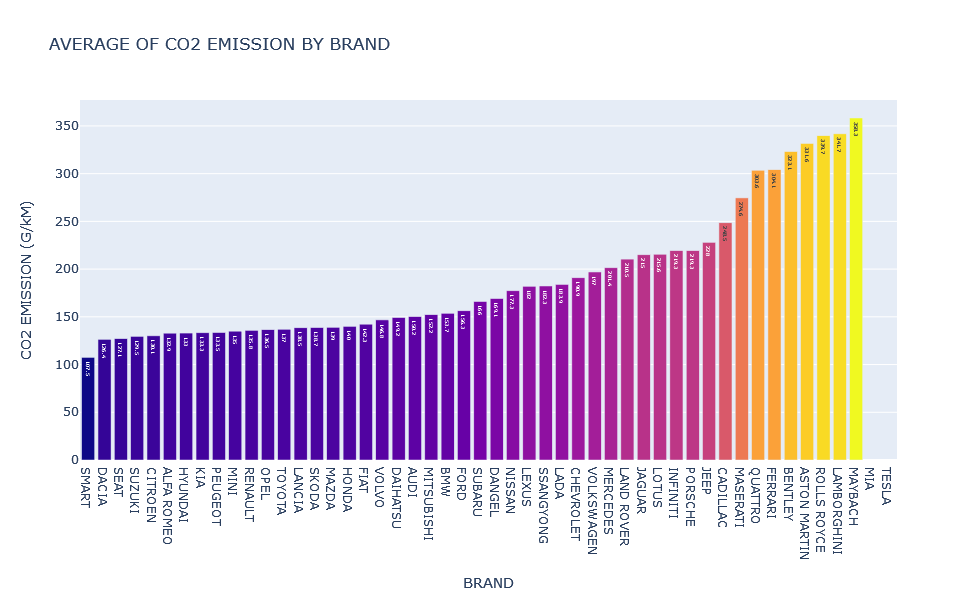

In [31]:
fig = px.bar(
    data_frame=data_frame,
    x='lib_mrq_utac',
    y='co2',
    color='co2',
    title='AVERAGE OF CO2 EMISSION BY BRAND',
    # log_x=True,
    text_auto=True
)
fig.update_coloraxes(showscale=False)
fig.update_layout(
    height=600,
    legend=dict(title='CO2 (G/KM)'),
    xaxis_title='BRAND',
    yaxis_title='CO2 EMISSION (G/kM)'
)

fig.show()
img_path = os.path.join(dataviz_dir, "imgs", "0-AVERAGE OF CO2 EMISSION BY BRAND.svg")
save_picke_file(fig, img_path.replace(".svg", ".pkl"))
fig.write_image(img_path, width=1400, height=600)

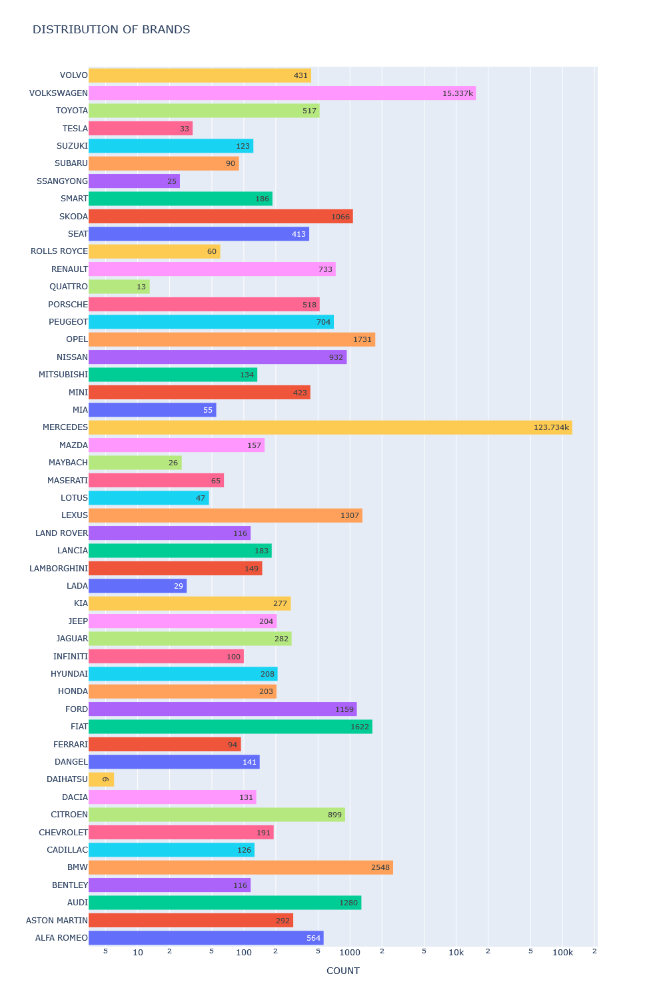

In [47]:
data_frame = df['lib_mrq_utac'].sort_values()
fig = px.histogram(
    y=data_frame,
    color=data_frame,
    title='DISTRIBUTION OF BRANDS',
    log_x=True,
    text_auto=True
)
fig.update_layout(
    height=1500,
    # legend=dict(title='BRANDS'),
    xaxis_title='COUNT',
    yaxis_title='',
    showlegend=False
)
fig.show()
img_path = os.path.join(dataviz_dir, "imgs", "1-DISTRIBUTION OF BRANDS.svg")
save_picke_file(fig, img_path.replace(".svg", ".pkl"))
fig.write_image(img_path, width=1800, height=1500)

> ### `lib_mod_doss`

In [36]:
# Strip extra white space
df.lib_mod_doss.loc[:] = df.lib_mod_doss.apply(lambda x: x.strip())
list = df.lib_mod_doss.unique()

In [37]:
print('LIST OF UNIQUE VALUES\n--------')
list_to_cols(sorted(list), 6)

LIST OF UNIQUE VALUES
--------
000: 107                           001: 108                           002: 159                           003: 2008                          004: 206+                          005: 207                           
006: 208                           007: 2171                          008: 2172                          009: 3008                          010: 308                           011: 370Z                          
012: 370Z ROADSTER                 013: 4007                          014: 4008                          015: 458                           016: 4C                            017: 4X4                           
018: 500                           019: 500 ABARTH                    020: 5008                          021: 500C                          022: 500C ABARTH                   023: 500L                          
024: 508                           025: 807                           026: 86                            027: 911            

> ### `lib_mod`

In [38]:
# Strip extra white space
df.lib_mod.loc[:] = df.lib_mod.apply(lambda x: x.strip())
list = df.lib_mod.unique()

In [39]:
print('LIST OF UNIQUE VALUES\n--------')
list_to_cols(sorted(list), 6)

LIST OF UNIQUE VALUES
--------
000: 107                           001: 108                           002: 114                           003: 116                           004: 118                           005: 120                           
006: 123                           007: 125                           008: 130                           009: 135                           010: 159                           011: 2                             
012: 2008                          013: 206+                          014: 207                           015: 208                           016: 214                           017: 216                           
018: 218                           019: 220                           020: 225                           021: 228                           022: 235                           023: 3                             
024: 3008                          025: 308                           026: 316                           027: 318            

> ### `dscom`

In [40]:
# Strip extra white space
df.dscom

0                             159 1750 Tbi (200ch) 
1                         159 2.0 JTDm (170ch) ECO 
2                             159 2.0 JTDm (136ch) 
3                             159 2.0 JTDm (136ch) 
4                             159 2.0 JTDm (170ch) 
                            ...                    
40047       BRAVO 1.6 MultiJet (120ch) Sport Euro 5
40048             BRAVO 2.0 MultiJet (165ch) Euro 5
40049       BRAVO 2.0 MultiJet (165ch) Sport Euro 5
40050    Delta 1.6 MultiJet (120ch) DPF Selectronic
40051      Delta 1.9 MultiJet Twinturbo (190ch) DPF
Name: dscom, Length: 159780, dtype: object

<div class="alert alert-block alert-success">
    <b>Feature engineering:</b> 
    <br>Extract engine power and cylinder volume from dscom.
</div>

> ### `cnit`

In [41]:
df.cnit

0        M10ALFVP000G340 
1        M10ALFVP000U221 
2        M10ALFVP000E302 
3        M10ALFVP000F303 
4        M10ALFVP000G304 
               ...       
40047        MFT5422JX524
40048        MFT5722JS525
40049        MFT5722JT526
40050        MLC5402BX575
40051        MLC5802B7581
Name: cnit, Length: 159780, dtype: object

> We do not find, in this first analysis an interest on these values, it will therefore be dropped.

In [42]:
df = df.drop('cnit', axis=1)

> ### `tvv`

In [43]:
df.tvv

0        939AXN1B52C 
1        939AXP1B54C 
2         939AXR1B64 
3        939AXR1B64B 
4         939AXS1B66 
             ...     
40047     198AXL1B08D
40048     198AXN1B12C
40049     198AXN1B12D
40050     844AXC1105C
40051     844AXE1A04C
Name: tvv, Length: 159780, dtype: object

<div class="alert alert-block alert-success">
    <b>Feature engineering:</b> 
    <br>The ‘tvv’, as an unique identification number can be used to complete the French government data with new variables from EEA dataset. Ex.: wheelbase, track width..
</div>

> ### `cod_cbr`

In [44]:
# Strip extra white space
df.cod_cbr.loc[:] = df.cod_cbr.apply(lambda x: x.strip())
list = df.cod_cbr.unique()

In [45]:
print('LIST OF UNIQUE VALUES\n--------')
list_to_cols(sorted(list), 6)

LIST OF UNIQUE VALUES
--------
000: EE                            001: EH                            002: EL                            003: ES                            004: ES/GN                         005: ES/GP                         
006: FE                            007: GH                            008: GL                            009: GN                            010: GN/ES                         011: GO                            
012: GP/ES                         

> The following values are merged before this analysis: `ES/GN` → `GN/ES` and `GP/ES` → `ES/GP`.

In [46]:
df.cod_cbr = df.cod_cbr.replace(
    to_replace=["ES/GN", "GP/ES", ],
    value=     ["GN/ES", "ES/GP"]
)

> We expect that the Type of fuel will have a big impact in the CO2 emissions.
>
> Lets try to visualize that in a plot:

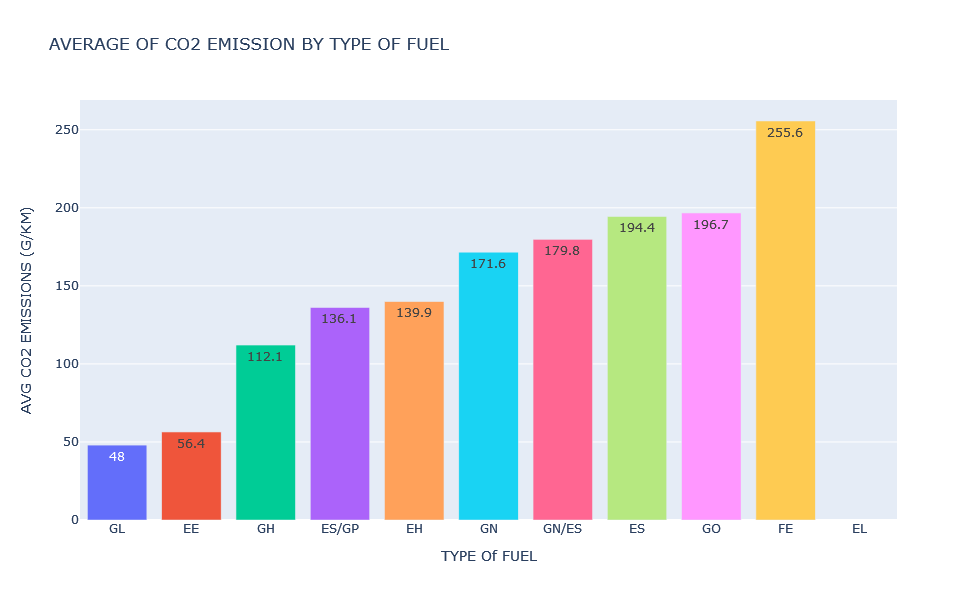

In [48]:
data_frame = df.groupby('cod_cbr')['co2'].mean().sort_values(ascending=True).round(1)
fig = px.bar(
    x=data_frame.index,
    y=data_frame,
    color=data_frame.index,
    title='AVERAGE OF CO2 EMISSION BY TYPE OF FUEL',
    # log_x=True,
    text_auto=True
)
fig.update_layout(
    height=600,
    # legend=dict(title='BRANDS'),
    xaxis_title='TYPE Of FUEL',
    yaxis_title='AVG CO2 EMISSIONS (G/KM)',
    showlegend=False
)

fig.show()
img_path = os.path.join(dataviz_dir, "imgs", "2-AVERAGE OF CO2 EMISSION BY TYPE OF FUEL.svg")
save_picke_file(fig, img_path.replace(".svg", ".pkl"))
fig.write_image(img_path, width=1400, height=600)

> We confirm that the type of fuel has a big impact in co2 emissions.
>
> We can also see that EL, that stands for electrical has zero emissions.

In [49]:
df.cod_cbr[df.hybride=='oui'].value_counts()

cod_cbr
EH    497
GH    135
ES    105
GO     27
EE     14
GL      2
Name: count, dtype: int64

<div class="alert alert-block alert-warning">
    <b>Action:</b> 
    <br>Identify the number of car brands using each fuel type and compare the proportions to get a bigger picture for why CO2 emissions differ between each brand. 
    <br>This analysis can further inform the findings from Graph #1..
</div>

<div class="alert alert-block alert-warning">
    <b>Action:</b> 
    <br>Replace fuel type by the correct values. To do this, it’s possible to check the fuel type of a car of another year of the French Government dataset by using the variable ‘tvv’ (if the ‘tvv’ variable is similar, it means that this is exactly the same car with the same characteristics).
</div>

> ### `hybride`

In [50]:
# Strip extra white space
df.hybride.loc[:] = df.hybride.apply(lambda x: x.strip())
list = df.hybride.unique()

In [51]:
print('LIST OF UNIQUE VALUES\n--------')
list_to_cols(sorted(list), 1)

LIST OF UNIQUE VALUES
--------
000: non                           
001: oui                           


In [52]:
data_frame = df.groupby(['cod_cbr','hybride'])['co2'].mean().sort_values(ascending=True).round(1)
data_frame = data_frame.reset_index()

> We expect that a hybrid car will produce less CO2 than a non-hybrid.

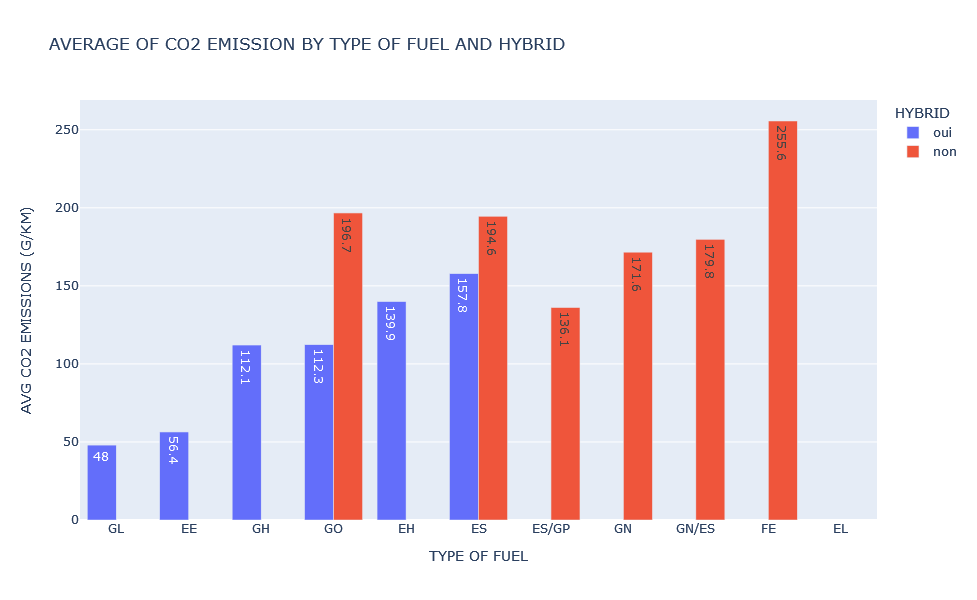

In [53]:
fig = px.bar(
    data_frame=data_frame,
    x='cod_cbr',
    y='co2',
    color='hybride',
    title='AVERAGE OF CO2 EMISSION BY TYPE OF FUEL AND HYBRID',
    text_auto=True,
    barmode='group'
)
fig.update_layout(
    height=600,
    legend=dict(title='HYBRID'),
    xaxis_title='TYPE OF FUEL',
    yaxis_title='AVG CO2 EMISSIONS (G/KM)'
)

fig.show()
img_path = os.path.join(dataviz_dir, "imgs", "3-AVERAGE OF CO2 EMISSION BY TYPE OF FUEL AND HYBRID.svg")
save_picke_file(fig, img_path.replace(".svg", ".pkl"))
fig.write_image(img_path, width=1400, height=600)

> We can see, as expexted that a hybrid car has an average lower consumption, compared to a non-hybrid.

> ### `typ_boite_nb_rapp`

In [54]:
# Strip extra white space
df.typ_boite_nb_rapp.loc[:] = df.typ_boite_nb_rapp.apply(lambda x: x.strip())
list = df.typ_boite_nb_rapp.unique()

In [55]:
print('LIST OF UNIQUE VALUES\n--------')
list_to_cols(sorted(list), 7)

LIST OF UNIQUE VALUES
--------
000: A 0                           001: A 1                           002: A 4                           003: A 5                           004: A 6                           005: A 7                           006: A 8                           
007: A 9                           008: D 5                           009: D 6                           010: D 7                           011: M 0                           012: M 1                           013: M 5                           
014: M 6                           015: M 7                           016: N 0                           017: N 1                           018: S 6                           019: V .                           020: V 0                           
021: V 1                           

In [56]:
data_frame = df.groupby(['typ_boite_nb_rapp','hybride'])['co2'].mean().sort_values(ascending=True).round(1)
data_frame = data_frame.reset_index()

> We expect that a hybrid car will produce less CO2 than a non-hybrid.

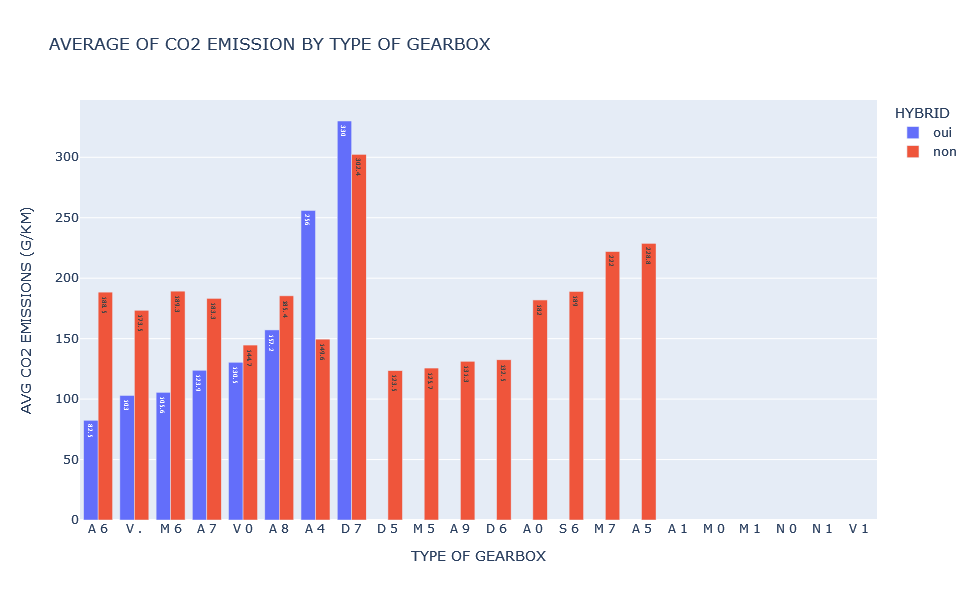

In [57]:
fig = px.bar(
    data_frame=data_frame,
    x='typ_boite_nb_rapp',
    y='co2',
    color='hybride',
    title='AVERAGE OF CO2 EMISSION BY TYPE OF GEARBOX',
    text_auto=True,
    barmode='group'
)
fig.update_layout(
    height=600,
    legend=dict(title='HYBRID'),
    xaxis_title='TYPE OF GEARBOX',
    yaxis_title='AVG CO2 EMISSIONS (G/KM)'
)

fig.show()
img_path = os.path.join(dataviz_dir, "imgs", "4-AVERAGE OF CO2 EMISSION BY TYPE OF GEARBOX.svg")
save_picke_file(fig, img_path.replace(".svg", ".pkl"))
fig.write_image(img_path, width=1400, height=600)

<div class="alert alert-block alert-success">
    <b>Feature engineering:</b> 
    <br>Separate First letter and number in different features and check the correlation of each category with co2 emissions.
</div>

> ### `champ_v9`

In [58]:
df.champ_v9

0        715/2007*692/2008EURO5 
1        715/2007*692/2008EURO5 
2        715/2007*692/2008EURO5 
3        715/2007*692/2008EURO5 
4        715/2007*692/2008EURO5 
                  ...           
40047     715/2007*692/2008EURO5
40048     715/2007*692/2008EURO5
40049     715/2007*692/2008EURO5
40050     715/2007*692/2008EURO5
40051     715/2007*692/2008EURO5
Name: champ_v9, Length: 159780, dtype: object

<div class="alert alert-block alert-success">
    <b>Feature engineering:</b> 
    <br>Investigate if certified or no certified car has an impact on the CO2 emissions. A binary variable can be created.
</div>

> ### `date_maj`

> We expect the update date not to have a correlation with the CO2 emissions, but lets take a look at it, as it contains the year
> that could be interesting to extract later to see the trend of CO2 emission by year.

In [59]:
df.date_maj.value_counts()

date_maj
juin-13    43534
mars-15    19940
mars-14     2805
mars-13     1017
juin-14      718
déc-14       201
dÚc-13       119
sept-13       17
déc-12         1
Name: count, dtype: int64

In [60]:
data_frame = df.groupby(['date_maj'])['co2'].mean().round(2)
data_frame = data_frame.reset_index()
data_frame.replace(
    ['dÚc', 'déc', 'juin', 'mars', 'sept'],
    ['December', 'December', 'June', 'March', 'September'], 
    regex=True, inplace=True)
data_frame['datetime'] = pd.to_datetime(data_frame.date_maj, format='%B-%y')
data_frame['year'] = data_frame.date_maj.apply(lambda x: x[-2:])
data_frame = data_frame.sort_values(by='datetime')
data_frame

,date_maj,co2,datetime,year
1,December-12,212.00,2012-12-01,12
5,March-13,194.64,2013-03-01,13
3,June-13,199.52,2013-06-01,13
8,September-13,208.93,2013-09-01,13
0,December-13,135.19,2013-12-01,13
6,March-14,165.25,2014-03-01,14
4,June-14,138.73,2014-06-01,14
2,December-14,140.34,2014-12-01,14
7,March-15,155.24,2015-03-01,15


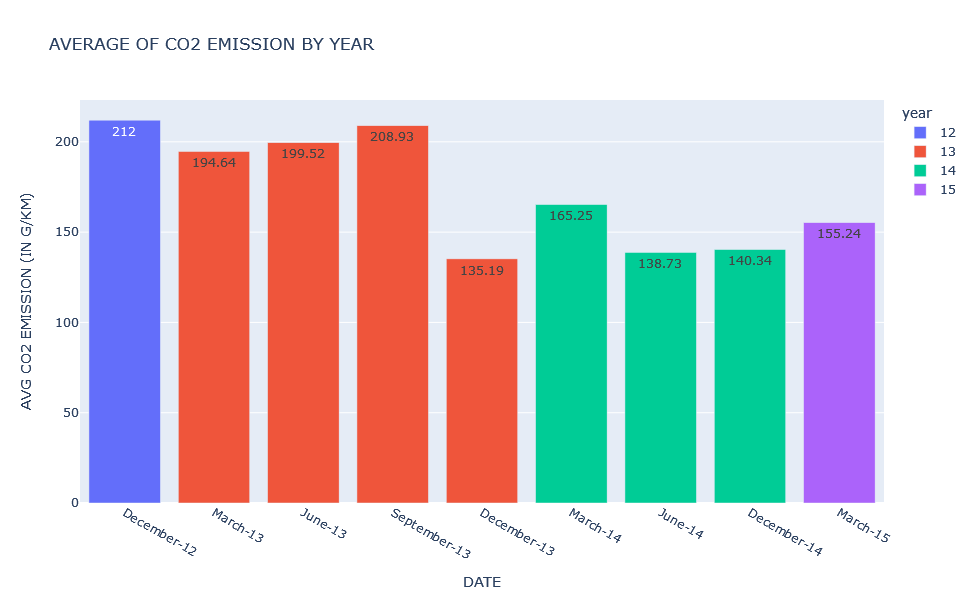

In [61]:
fig = px.bar(
    data_frame=data_frame,
    x='date_maj',
    y='co2',
    color='year',
    title='AVERAGE OF CO2 EMISSION BY YEAR',
    text_auto=True,
    # barmode='group'
)
fig.update_layout(
    height=600,
    xaxis_title='DATE',
    yaxis_title='AVG CO2 EMISSION (IN G/KM)'
)

fig.show()
img_path = os.path.join(dataviz_dir, "imgs", "5-AVERAGE OF CO2 EMISSION BY YEAR.svg")
save_picke_file(fig, img_path.replace(".svg", ".pkl"))
fig.write_image(img_path, width=1400, height=600)

> CO2 average emissions seems to be decreasing slowly each year. We must be careful because we did not yet remove electrical cars that grew more in the latest years, and could impact the average if it is computed in the calculation.

<div class="alert alert-block alert-success">
    <b>Feature engineering:</b> 
    <br>Create a column year from file name. This can be used to split the test / train data by year. We can train the dataset in older years and test it in the most recent data.
</div>

> ### `Carrosserie`

In [62]:
df.Carrosserie.value_counts()

Carrosserie
MINIBUS                110837
BERLINE                 12432
BREAK                    5015
TS TERRAINS/CHEMINS      2992
COUPE                    2692
CABRIOLET                1561
COMBISPACE               1416
MONOSPACE COMPACT        1275
MINISPACE                 435
MONOSPACE                 241
COMBISPCACE                 4
Name: count, dtype: int64

In [63]:
df.Carrosserie.unique()

array([nan, 'BERLINE', 'BREAK', 'COUPE', 'CABRIOLET',
       'TS TERRAINS/CHEMINS', 'COMBISPACE', 'MINISPACE',
       'MONOSPACE COMPACT', 'MONOSPACE', 'MINIBUS', 'COMBISPCACE'],
      dtype=object)

In [64]:
print('LIST OF UNIQUE VALUES\n--------')
list_to_cols(sorted(df.Carrosserie.unique()[1:]), 3)

LIST OF UNIQUE VALUES
--------
000: BERLINE                       001: BREAK                         002: CABRIOLET                     
003: COMBISPACE                    004: COMBISPCACE                   005: COUPE                         
006: MINIBUS                       007: MINISPACE                     008: MONOSPACE                     
009: MONOSPACE COMPACT             010: TS TERRAINS/CHEMINS           

In [65]:
data_frame = df.groupby(['Carrosserie','cod_cbr'])['co2'].mean().sort_values(ascending=True).round(1)
data_frame = data_frame.reset_index()
data_frame

,Carrosserie,cod_cbr,co2
0,BERLINE,EE,37.7
1,TS TERRAINS/CHEMINS,EE,44.0
2,BREAK,GL,48.0
3,COUPE,EE,71.0
4,BREAK,EH,88.5
5,MINISPACE,EH,104.0
6,BERLINE,GN/ES,107.0
7,BERLINE,GH,113.9
8,MONOSPACE COMPACT,GN,116.9
9,BREAK,GH,117.8


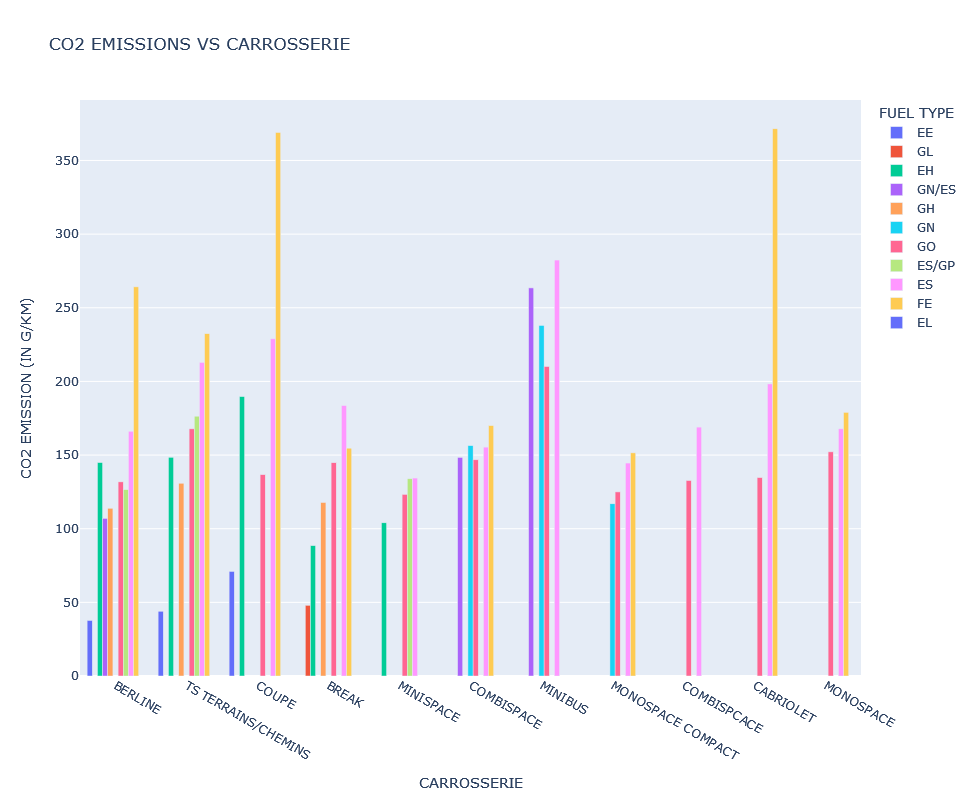

In [67]:
fig = px.bar(
    data_frame=data_frame,
    x='Carrosserie',
    y='co2',
    color='cod_cbr',
    title='CO2 EMISSIONS VS CARROSSERIE',
    barmode='group'
)
fig.update_layout(
    height=800,
    legend=dict(title='FUEL TYPE'),
    xaxis_title='CARROSSERIE',
    yaxis_title='CO2 EMISSION (IN G/KM)'
)

fig.show()
img_path = os.path.join(dataviz_dir, "imgs", "6-CO2 EMISSIONS VS CARROSSERIE AND COD_CBR.svg")
save_picke_file(fig, img_path.replace(".svg", ".pkl"))
fig.write_image(img_path, width=1400, height=600)

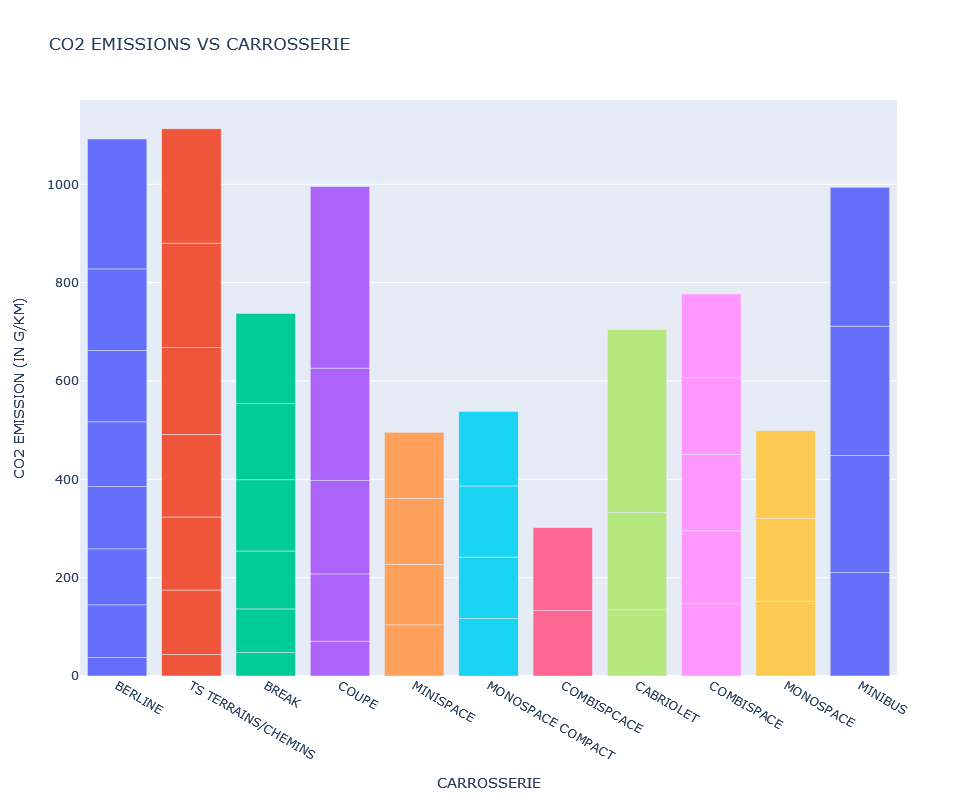

In [68]:
fig = px.bar(
    data_frame=data_frame,
    x='Carrosserie',
    y='co2',
    color='Carrosserie',
    title='CO2 EMISSIONS VS CARROSSERIE'
)
fig.update_layout(
    height=800,
    xaxis_title='CARROSSERIE',
    yaxis_title='CO2 EMISSION (IN G/KM)',
    showlegend=False
)

fig.show()
img_path = os.path.join(dataviz_dir, "imgs", "7-CO2 EMISSIONS VS CARROSSERIE.svg")
save_picke_file(fig, img_path.replace(".svg", ".pkl"))
fig.write_image(img_path, width=1400, height=600)

> ### `gamme`

In [69]:
df.gamme.value_counts()

gamme
MOY-INFER         72530
MOY-SUPER         45334
LUXE              11714
SUPERIEURE         4907
INFERIEURE         3672
ECONOMIQUE          676
MOY-INFERIEURE       56
COUPE                 9
MOY-INF               2
Name: count, dtype: int64

In [70]:
df.gamme.unique()

array([nan, 'MOY-SUPER', 'LUXE', 'MOY-INFER', 'INFERIEURE', 'SUPERIEURE',
       'ECONOMIQUE', 'MOY-INFERIEURE', 'MOY-INF', 'COUPE'], dtype=object)

In [71]:
print('LIST OF UNIQUE VALUES\n--------')
list_to_cols(sorted(df.gamme.unique()[1:]), 3)

LIST OF UNIQUE VALUES
--------
000: COUPE                         001: ECONOMIQUE                    002: INFERIEURE                    
003: LUXE                          004: MOY-INF                       005: MOY-INFER                     
006: MOY-INFERIEURE                007: MOY-SUPER                     008: SUPERIEURE                    


> The following variables are to be merged: `MOY-INF`, `MOY-INFER` --> `MOY-INFERIEURE`

In [72]:
df.gamme = df.gamme.replace(
    to_replace=["MOY-INF", "MOY-INFER"],
    value=     ["MOY-INFERIEURE", "MOY-INFERIEURE"]
)

In [73]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 159780 entries, 0 to 40051
Data columns (total 26 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   lib_mrq_utac       159780 non-null  object 
 1   lib_mod_doss       159780 non-null  object 
 2   lib_mod            159780 non-null  object 
 3   dscom              159780 non-null  object 
 4   tvv                159780 non-null  object 
 5   cod_cbr            159780 non-null  object 
 6   hybride            159780 non-null  object 
 7   puiss_admin_98     159780 non-null  int64  
 8   puiss_max          159724 non-null  object 
 9   typ_boite_nb_rapp  159780 non-null  object 
 10  conso_urb          159543 non-null  object 
 11  conso_exurb        159543 non-null  object 
 12  conso_mixte        159622 non-null  object 
 13  co2                159622 non-null  float64
 14  co_typ_1           159090 non-null  object 
 15  hc                 36813 non-null   object 
 16  nox     

In [74]:
data_frame = df.groupby(['gamme','cod_cbr'])['co2'].mean().sort_values(ascending=True).round(1)
data_frame = data_frame.reset_index()
data_frame

,gamme,cod_cbr,co2
0,INFERIEURE,EE,13.0
1,MOY-INFERIEURE,EE,27.0
2,MOY-SUPER,EE,47.3
3,SUPERIEURE,GL,48.0
4,LUXE,EE,71.0
5,INFERIEURE,EH,89.3
6,MOY-INFERIEURE,GH,93.0
7,MOY-INFERIEURE,EH,93.4
8,MOY-SUPER,GH,95.7
9,MOY-SUPER,EH,102.0


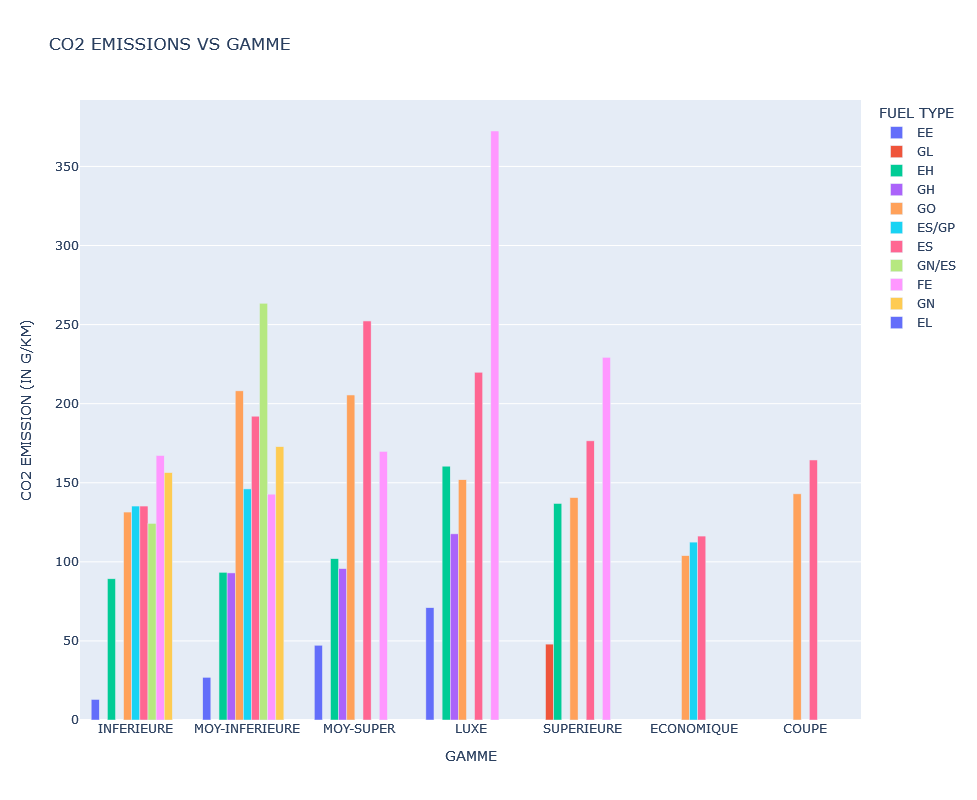

In [75]:
fig = px.bar(
    data_frame=data_frame,
    x='gamme',
    y='co2',
    color='cod_cbr',
    title='CO2 EMISSIONS VS GAMME',
    barmode='group'
)
fig.update_layout(
    height=800,
    legend=dict(title='FUEL TYPE'),
    xaxis_title='GAMME',
    yaxis_title='CO2 EMISSION (IN G/KM)'
)

fig.show()
img_path = os.path.join(dataviz_dir, "imgs", "8-CO2 EMISSIONS VS GAMME.svg")
save_picke_file(fig, img_path.replace(".svg", ".pkl"))
fig.write_image(img_path, width=1400, height=600)

## 5.2. Quantitative Variables 

> ### `puiss_admin_98`

In [76]:
df.puiss_admin_98.isna().sum()

0

In [77]:
df.puiss_admin_98 = df.puiss_admin_98.astype('float64')

> ### `puiss_max`

In [78]:
df.puiss_admin_98.isna().sum()

0

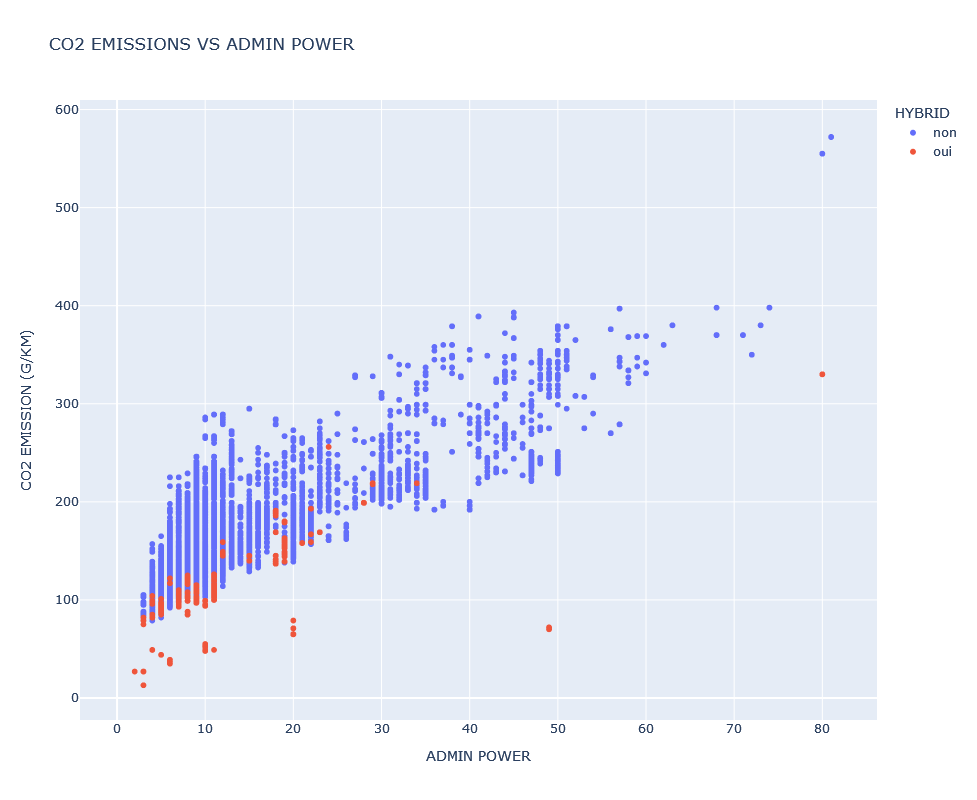

In [80]:
fig = px.scatter(
    data_frame=df,
    x='puiss_admin_98',
    y='co2',
    color='hybride',
    # symbol='cod_cbr',
    title='CO2 EMISSIONS VS ADMIN POWER'
)
fig.update_layout(
    height=800,
    legend=dict(title='HYBRID'),
    xaxis_title='ADMIN POWER',
    yaxis_title='CO2 EMISSION (G/KM)'
)

fig.show()
img_path = os.path.join(dataviz_dir, "imgs", "9-CO2 EMISSIONS VS ADMIN POWER.svg")
save_picke_file(fig, img_path.replace(".svg", ".pkl"))
fig.write_image(img_path, width=1800, height=1500)

> ### `puiss_max`

> `puiss_max` will probably be used later as a categorical variable, by separating it in bins. Let’s check the influence of this variable on the CO2 emissions:

In [81]:
df.puiss_max = df.puiss_max.replace(',', '.', regex=True).astype('float64')

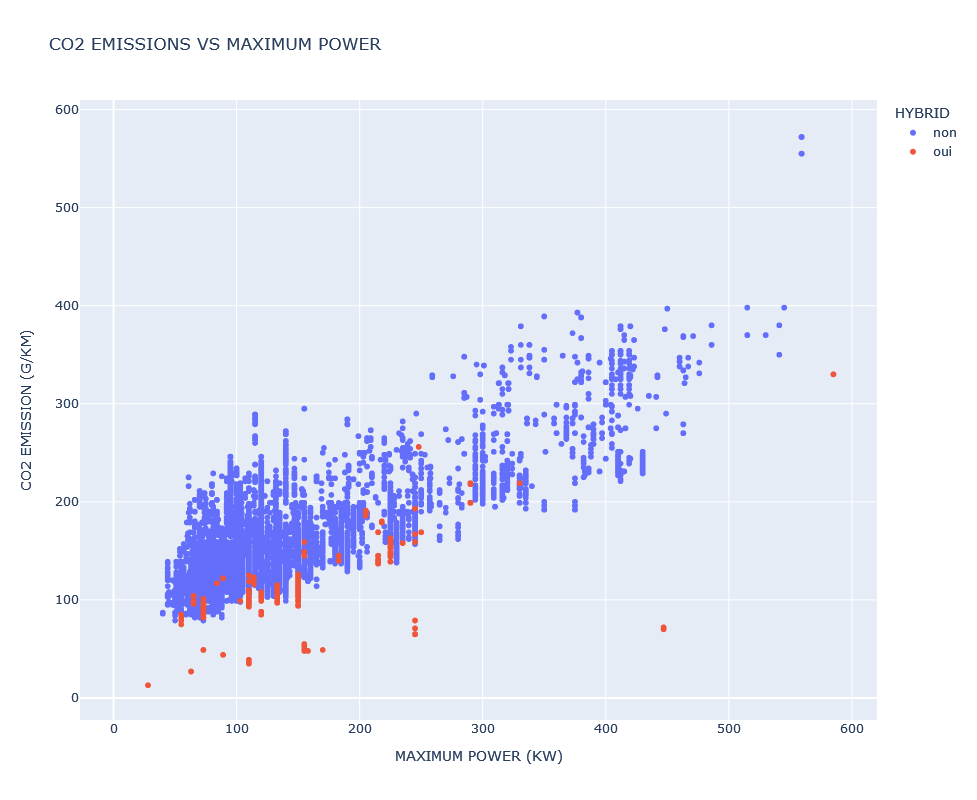

In [83]:
fig = px.scatter(
    data_frame=df,
    x='puiss_max',
    y='co2',
    color='hybride',
    # symbol='cod_cbr',
    title='CO2 EMISSIONS VS MAXIMUM POWER'
)
fig.update_layout(
    height=800,
    legend=dict(title='HYBRID'),
    xaxis_title='MAXIMUM POWER (KW)',
    yaxis_title='CO2 EMISSION (G/KM)'
)

fig.show()
img_path = os.path.join(dataviz_dir, "imgs", "10-CO2 EMISSIONS VS MAXIMUM POWER.svg")
save_picke_file(fig, img_path.replace(".svg", ".pkl"))
fig.write_image(img_path, width=1800, height=1500)

> ### `conso_urb`

In [84]:
df.conso_urb = df.conso_urb.replace(',', '.', regex=True).astype('float64')

> ### `conso_exurb`

In [85]:
df.conso_exurb = df.conso_exurb.replace(',', '.', regex=True).astype('float64')

> ### `conso_mixte`

In [86]:
df.conso_mixte = df.conso_mixte.replace(',', '.', regex=True).astype('float64')

> ### `co2` **[TARGET VARIABLE]**

In [87]:
df.co2.isna().sum()

158

<div class="alert alert-block alert-success">
    <b>Feature engineering:</b> 
    <br>Split co2 emission in classes (ex.: low, high, average, high and very high) to use it in classification models. Ranges to be defined later.
</div>

> ### `co_typ_1`

In [88]:
df.co_typ_1 = df.co_typ_1.replace(',', '.', regex=True).astype('float64')

> ### `hc`

In [89]:
df.hc = df.hc.replace(',', '.', regex=True).astype('float64')

> ### `nox`

In [90]:
df.nox = df.nox.replace(',', '.', regex=True).astype('float64')

> ### `hcnox`

In [91]:
df.hcnox = df.hcnox.replace(',', '.', regex=True).astype('float64')

<div class="alert alert-block alert-success">
    <b>Feature engineering:</b> 
    <br>If we have 2 filled value out of 3 for the variables hc, nox and hcnox, replace the NaN value using the assumption that hc + nox = hcnox.
</div>

> ### `ptcl`

In [92]:
df.ptcl = df.ptcl.replace(',', '.', regex=True).astype('float64')

> ### `masse_ordma_min`

In [93]:
df.masse_ordma_min.isna().sum()

0

In [94]:
df.masse_ordma_min = df.masse_ordma_min.astype('float64')

> ### `masse_ordma_max`

In [95]:
df.masse_ordma_max.isna().sum()

0

In [96]:
df.masse_ordma_max = df.masse_ordma_max.astype('float64')

<div class="alert alert-block alert-warning">
    <b>Action:</b> 
    <br>Some cars have the same min and max mass order (around 47 000 cars) while it is different for the others. If the variable max mass is kept during the next phase, this problematic must be investigated.
</div>

## 5.2.1. Correlations and Distribution

In [97]:
num_vars_list = [
    'co2',
    'puiss_admin_98',
    'puiss_max',
    'conso_urb',
    'conso_exurb',
    'conso_mixte',
    'co_typ_1',
    'hc',
    'nox',
    'hcnox',
    'ptcl',
    'masse_ordma_min',
    'masse_ordma_max'
]
num_vars = df[num_vars_list]

> Now that the variables are converted to numerical values

In [98]:
df[num_vars_list].info()

<class 'pandas.core.frame.DataFrame'>
Index: 159780 entries, 0 to 40051
Data columns (total 13 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   co2              159622 non-null  float64
 1   puiss_admin_98   159780 non-null  float64
 2   puiss_max        159724 non-null  float64
 3   conso_urb        159543 non-null  float64
 4   conso_exurb      159543 non-null  float64
 5   conso_mixte      159622 non-null  float64
 6   co_typ_1         159090 non-null  float64
 7   hc               36813 non-null   float64
 8   nox              159090 non-null  float64
 9   hcnox            122452 non-null  float64
 10  ptcl             150181 non-null  float64
 11  masse_ordma_min  159780 non-null  float64
 12  masse_ordma_max  159780 non-null  float64
dtypes: float64(13)
memory usage: 17.1 MB


In [99]:
df[num_vars_list].describe().round(2)

,co2,puiss_admin_98,puiss_max,conso_urb,conso_exurb,conso_mixte,co_typ_1,hc,nox,hcnox,ptcl,masse_ordma_min,masse_ordma_max
count,159622.00,159780.00,159724.00,159543.00,159543.00,159622.00,159090.00,36813.00,159090.00,122452.00,150181.00,159780.00,159780.00
mean,195.58,11.02,125.12,9.46,6.50,7.58,0.17,0.03,0.29,0.22,0.00,2059.24,2200.12
std,40.45,6.08,52.89,2.43,1.23,1.64,0.14,0.02,0.43,0.05,0.01,337.51,437.00
min,13.00,1.00,10.00,0.00,2.60,0.60,0.00,0.00,0.00,0.00,0.00,825.00,825.00
25%,182.00,9.00,100.00,8.70,6.30,7.10,0.06,0.01,0.15,0.20,0.00,1976.00,2000.00
50%,203.00,10.00,120.00,9.50,6.70,7.70,0.12,0.03,0.20,0.23,0.00,2076.00,2185.00
75%,216.00,11.00,120.00,10.30,7.10,8.30,0.26,0.04,0.23,0.25,0.00,2219.00,2585.00
max,572.00,81.00,585.00,41.10,15.90,24.50,0.97,0.51,1.85,0.57,0.70,3115.00,3115.00


In [100]:
list_to_cols(num_vars_list, 4)

000: co2                           001: puiss_admin_98                002: puiss_max                     003: conso_urb                     
004: conso_exurb                   005: conso_mixte                   006: co_typ_1                      007: hc                            
008: nox                           009: hcnox                         010: ptcl                          011: masse_ordma_min               
012: masse_ordma_max               

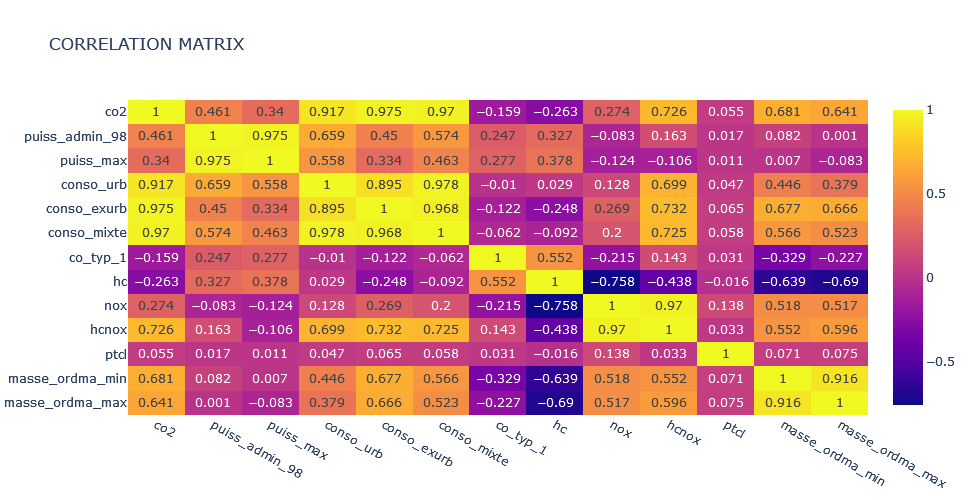

In [101]:
fig = px.imshow(
    num_vars.corr().round(3), 
    width=1400,
    height=500,
    text_auto=True,
    aspect='auto',
    title='CORRELATION MATRIX'
)
fig.show()

img_path = os.path.join(dataviz_dir, "imgs", "11-CORRELATION MATRIX.svg")
save_picke_file(fig, img_path.replace(".svg", ".pkl"))
fig.write_image(img_path, width=1800, height=1500)

In [102]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 159780 entries, 0 to 40051
Data columns (total 26 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   lib_mrq_utac       159780 non-null  object 
 1   lib_mod_doss       159780 non-null  object 
 2   lib_mod            159780 non-null  object 
 3   dscom              159780 non-null  object 
 4   tvv                159780 non-null  object 
 5   cod_cbr            159780 non-null  object 
 6   hybride            159780 non-null  object 
 7   puiss_admin_98     159780 non-null  float64
 8   puiss_max          159724 non-null  float64
 9   typ_boite_nb_rapp  159780 non-null  object 
 10  conso_urb          159543 non-null  float64
 11  conso_exurb        159543 non-null  float64
 12  conso_mixte        159622 non-null  float64
 13  co2                159622 non-null  float64
 14  co_typ_1           159090 non-null  float64
 15  hc                 36813 non-null   float64
 16  nox     

In [103]:
df.isna().sum() / len(df) * 100

lib_mrq_utac          0.000000
lib_mod_doss          0.000000
lib_mod               0.000000
dscom                 0.000000
tvv                   0.000000
cod_cbr               0.000000
hybride               0.000000
puiss_admin_98        0.000000
puiss_max             0.035048
typ_boite_nb_rapp     0.000000
conso_urb             0.148329
conso_exurb           0.148329
conso_mixte           0.098886
co2                   0.098886
co_typ_1              0.431844
hc                   76.960195
nox                   0.431844
hcnox                23.362123
ptcl                  6.007635
masse_ordma_min       0.000000
masse_ordma_max       0.000000
champ_v9              0.115784
date_maj             57.221179
year                  0.000000
Carrosserie          13.067968
gamme                13.067968
dtype: float64

### Boxplots

In [105]:
data_frame = [df[x].dropna().tolist() for x in num_vars]

In [106]:
len(data_frame)

13

In [107]:
len(num_vars)

159780

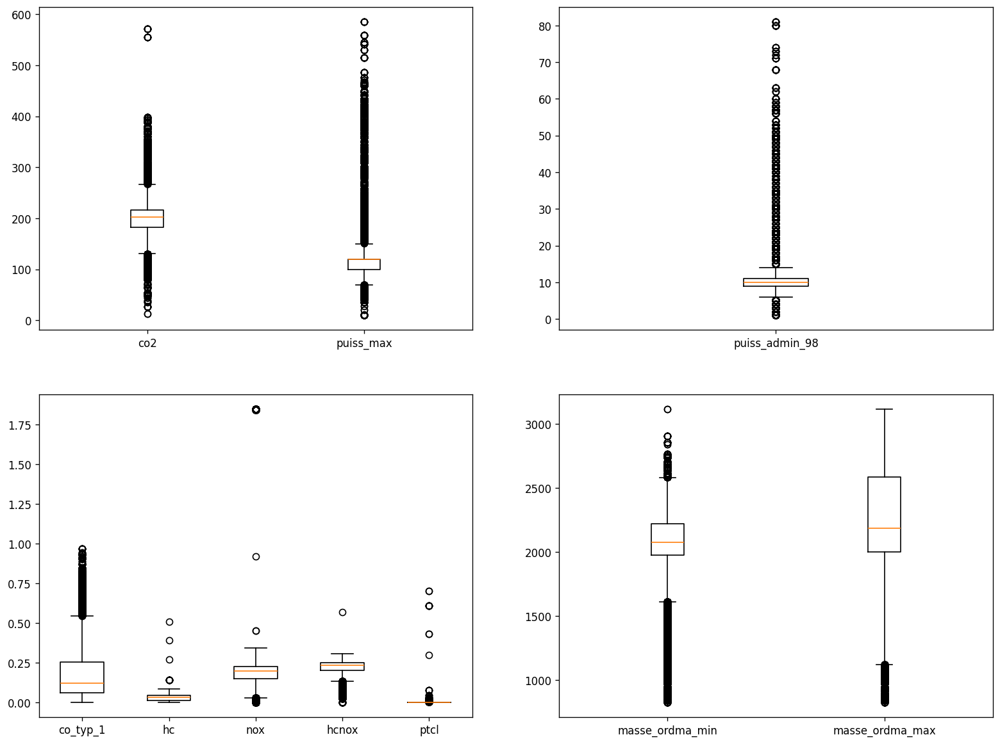

In [108]:
fig = plt.figure(figsize=(16,12))

# Co2 and puiss_max
# ---
ax1 = fig.add_subplot(221)
ax1.boxplot(
    [
        data_frame[0], # co2
        data_frame[2]  # puiss_max
    ]
)
ax1.set_xticklabels(
    labels=[
        num_vars_list[0],
        num_vars_list[2]
    ]
)

# puiss_max_98
# ---
ax2 = fig.add_subplot(222)
ax2.boxplot(
    data_frame[1:2]
)
ax2.set_xticklabels(labels=num_vars_list[1:2])

# Co2 and puiss_max
# ---
ax3 = fig.add_subplot(223)
ax3.boxplot(
    data_frame[6:11]
)
ax3.set_xticklabels(labels=num_vars_list[6:11])

# Co2 and puiss_max
# ---
ax4 = fig.add_subplot(224)
ax4.boxplot(
    data_frame[11:]
)
ax4.set_xticklabels(labels=num_vars_list[11:])

# ax2 = fig.add_subplot(131)
# ax2.boxplot(
#     data_frame
# )
# ax1.set_xticklabels(labels=num_vars_list, rotation=90)

plt.show()

# 6. Additional Data Vizualisation

## 6.1. Categorical Variables

### 6.1.1. Catplots

In [109]:
cat_vars = ['lib_mrq_utac', 'lib_mod_doss', 'lib_mod', 'dscom', 'cnit', 'tvv',
       'cod_cbr', 'hybride', 'typ_boite_nb_rapp', 'champ_v9', 'date_maj', 'Carrosserie', 'gamme']

In [110]:
df.columns

Index(['lib_mrq_utac', 'lib_mod_doss', 'lib_mod', 'dscom', 'tvv', 'cod_cbr',
       'hybride', 'puiss_admin_98', 'puiss_max', 'typ_boite_nb_rapp',
       'conso_urb', 'conso_exurb', 'conso_mixte', 'co2', 'co_typ_1', 'hc',
       'nox', 'hcnox', 'ptcl', 'masse_ordma_min', 'masse_ordma_max',
       'champ_v9', 'date_maj', 'year', 'Carrosserie', 'gamme'],
      dtype='object')

In [111]:
data_frame = df[['co2', 'hybride', 'cod_cbr', 'lib_mrq_utac', 'gamme', 'Carrosserie']].dropna()
data_frame

,co2,hybride,cod_cbr,lib_mrq_utac,gamme,Carrosserie
0,182.0,non,ES,ALFA ROMEO,MOY-SUPER,BERLINE
1,186.0,non,ES,ALFA ROMEO,MOY-SUPER,BERLINE
2,134.0,non,GO,ALFA ROMEO,MOY-SUPER,BERLINE
3,134.0,non,GO,ALFA ROMEO,MOY-SUPER,BERLINE
4,139.0,non,GO,ALFA ROMEO,MOY-SUPER,BERLINE
...,...,...,...,...,...,...
40047,129.0,non,GO,FIAT,MOY-INFERIEURE,BERLINE
40048,139.0,non,GO,FIAT,MOY-INFERIEURE,BERLINE
40049,139.0,non,GO,FIAT,MOY-INFERIEURE,BERLINE
40050,120.0,non,GO,LANCIA,MOY-INFERIEURE,BERLINE


In [112]:
data_frame.isna().sum()

co2             0
hybride         0
cod_cbr         0
lib_mrq_utac    0
gamme           0
Carrosserie     0
dtype: int64

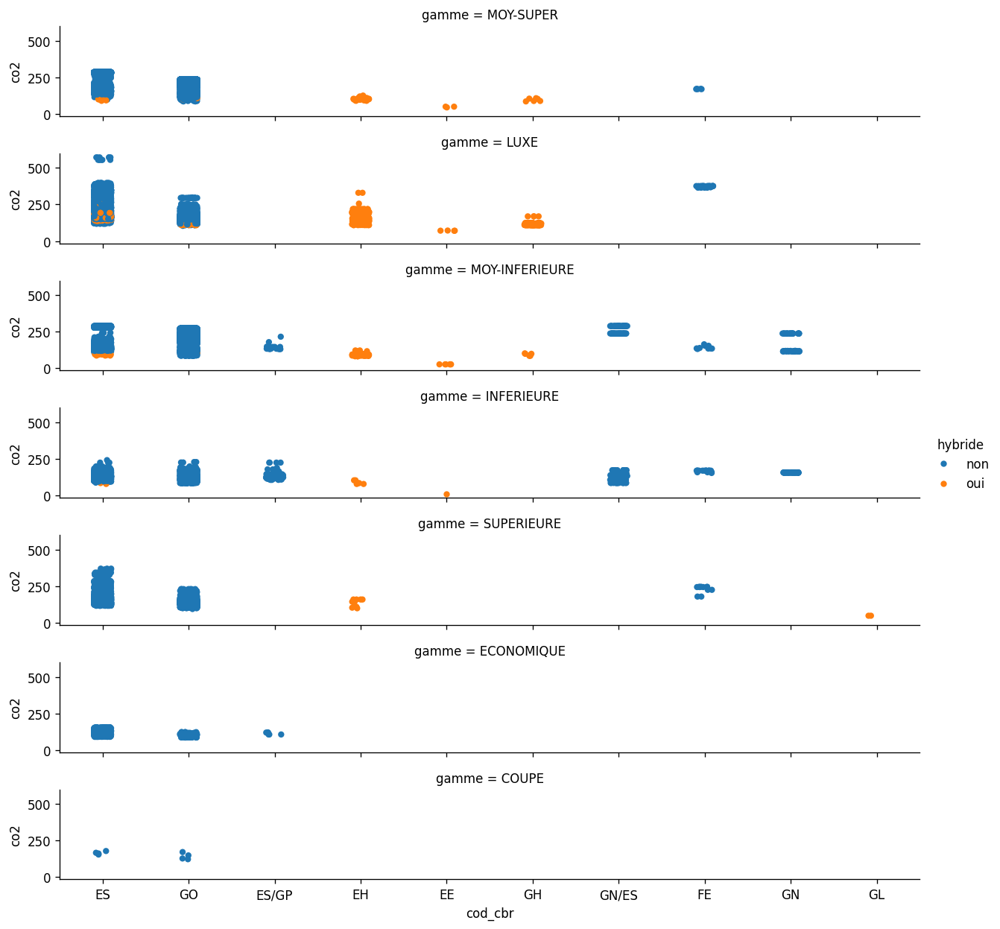

In [113]:
sns.catplot(
    data=data_frame,
    x='cod_cbr', 
    y ='co2',
    height=1.5,
    aspect=7, 
    row='gamme',
    hue='hybride'
)

plt.show()

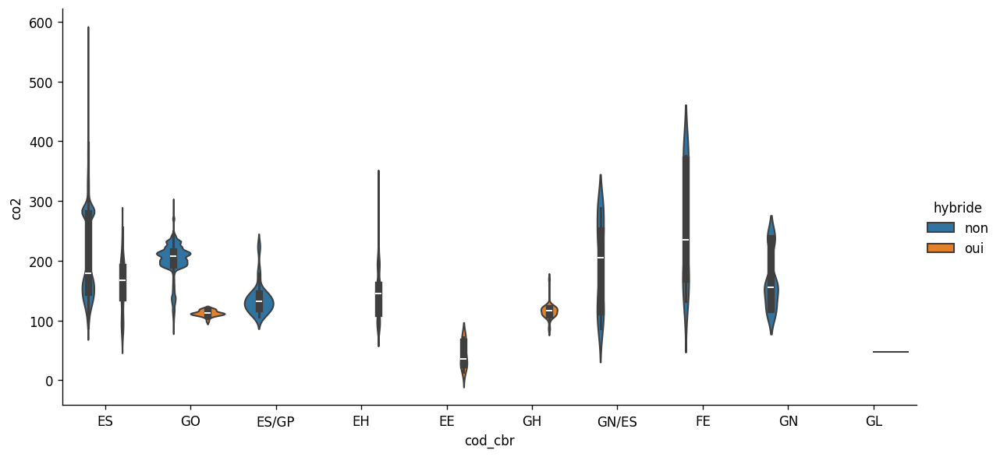

In [114]:
sns.catplot(
    data=data_frame,
    x='cod_cbr', 
    y ='co2',
    kind='violin',
    hue='hybride',
    height=5,
    aspect=2, 
)

plt.show()

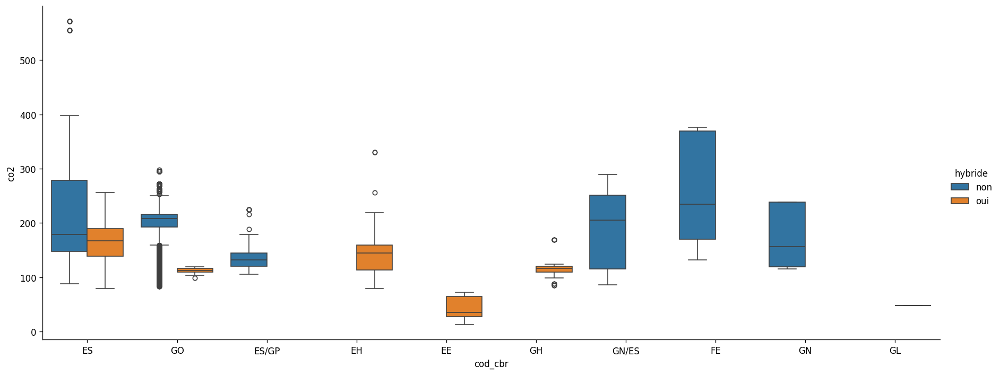

In [115]:
sns.catplot(
    data=data_frame,
    x='cod_cbr', 
    y ='co2',
    kind='box',
    hue='hybride',
    height=6,
    aspect=2.5, 
)

plt.show()

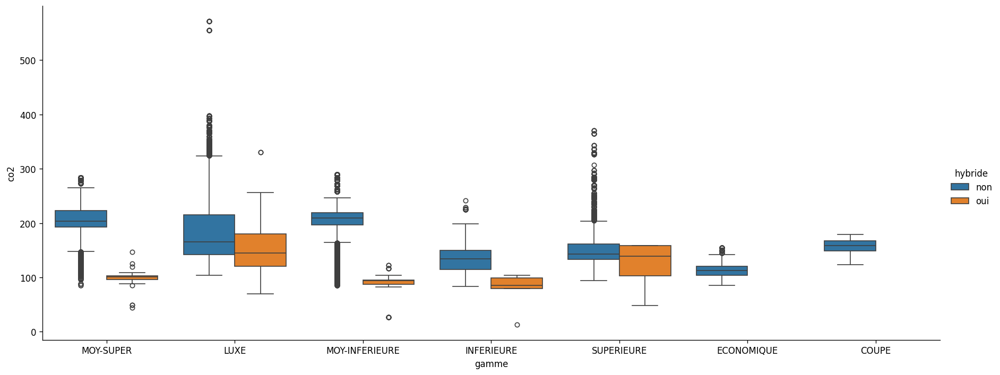

In [116]:
sns.catplot(
    data=data_frame,
    x='gamme', 
    y ='co2',
    kind='box',
    hue='hybride',
    height=6,
    aspect=2.5, 
)

plt.show()

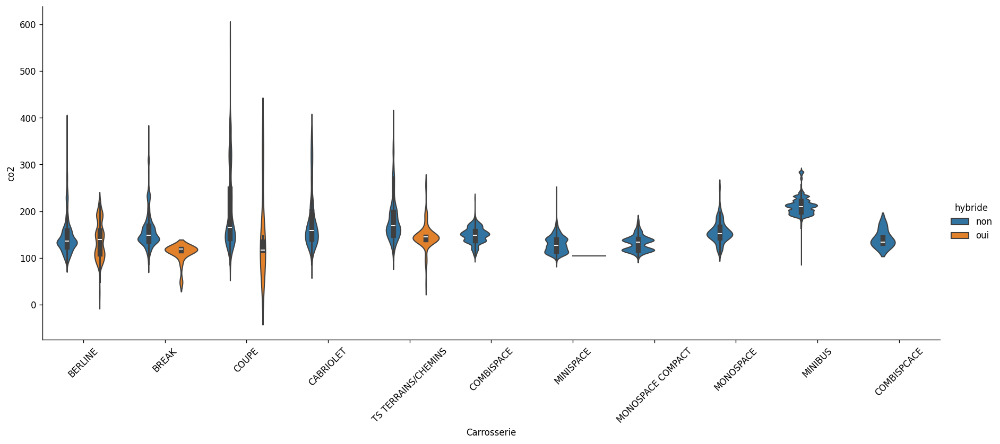

In [117]:
ax = sns.catplot(
    data=data_frame,
    x='Carrosserie', 
    y ='co2',
    kind='violin',
    hue='hybride',
    height=6,
    aspect=2.5, 
)
ax.set_xticklabels(rotation=45)
plt.show()

## 6.2. Quantitative Variables

In [118]:
df[num_vars_list].isna().sum()

co2                   158
puiss_admin_98          0
puiss_max              56
conso_urb             237
conso_exurb           237
conso_mixte           158
co_typ_1              690
hc                 122967
nox                   690
hcnox               37328
ptcl                 9599
masse_ordma_min         0
masse_ordma_max         0
dtype: int64

In [119]:
len(num_vars_list)

13

In [120]:
num_vars_list[:6]

['co2',
 'puiss_admin_98',
 'puiss_max',
 'conso_urb',
 'conso_exurb',
 'conso_mixte']

In [121]:
num_vars_list[6:]

['co_typ_1',
 'hc',
 'nox',
 'hcnox',
 'ptcl',
 'masse_ordma_min',
 'masse_ordma_max']

### 6.2.1. Pairplots

In [122]:
df.hybride.isna().sum()

0

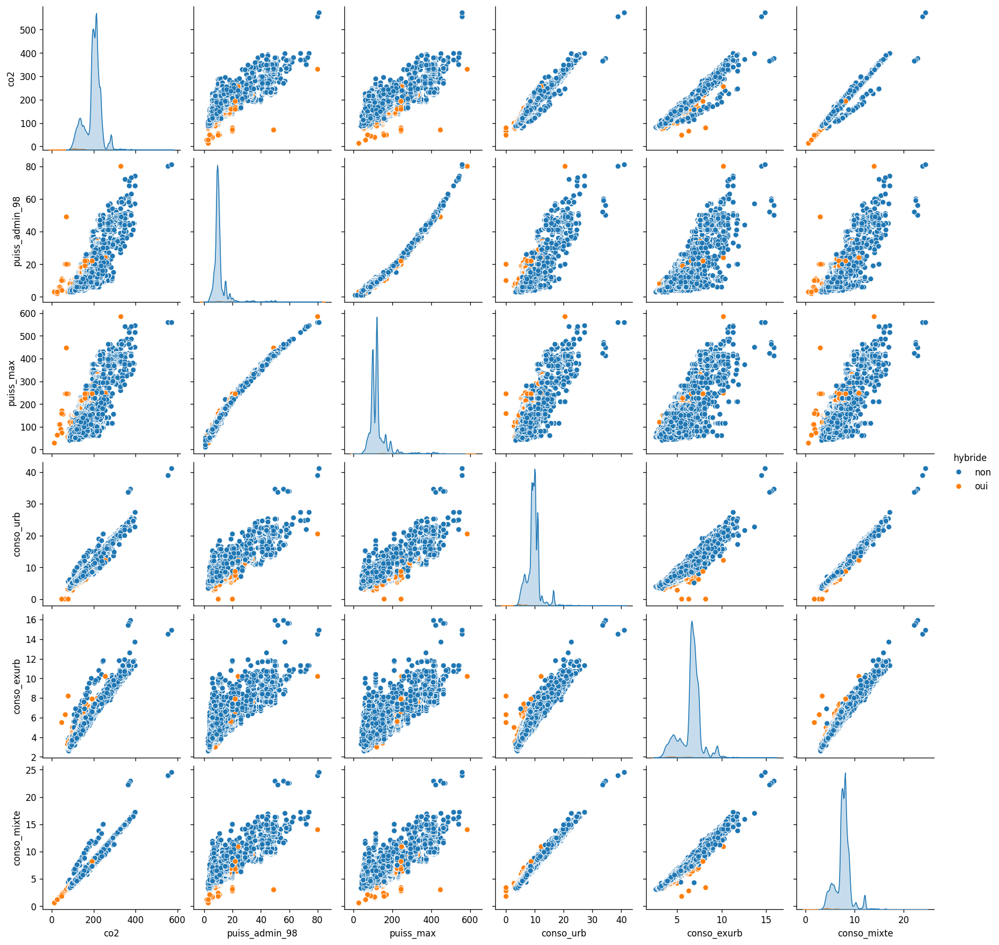

In [123]:
sns.pairplot(
    data=df[num_vars_list[:6]+['hybride']],
    dropna=True,
    hue='hybride',
    diag_kind='kde'
)

plt.show()

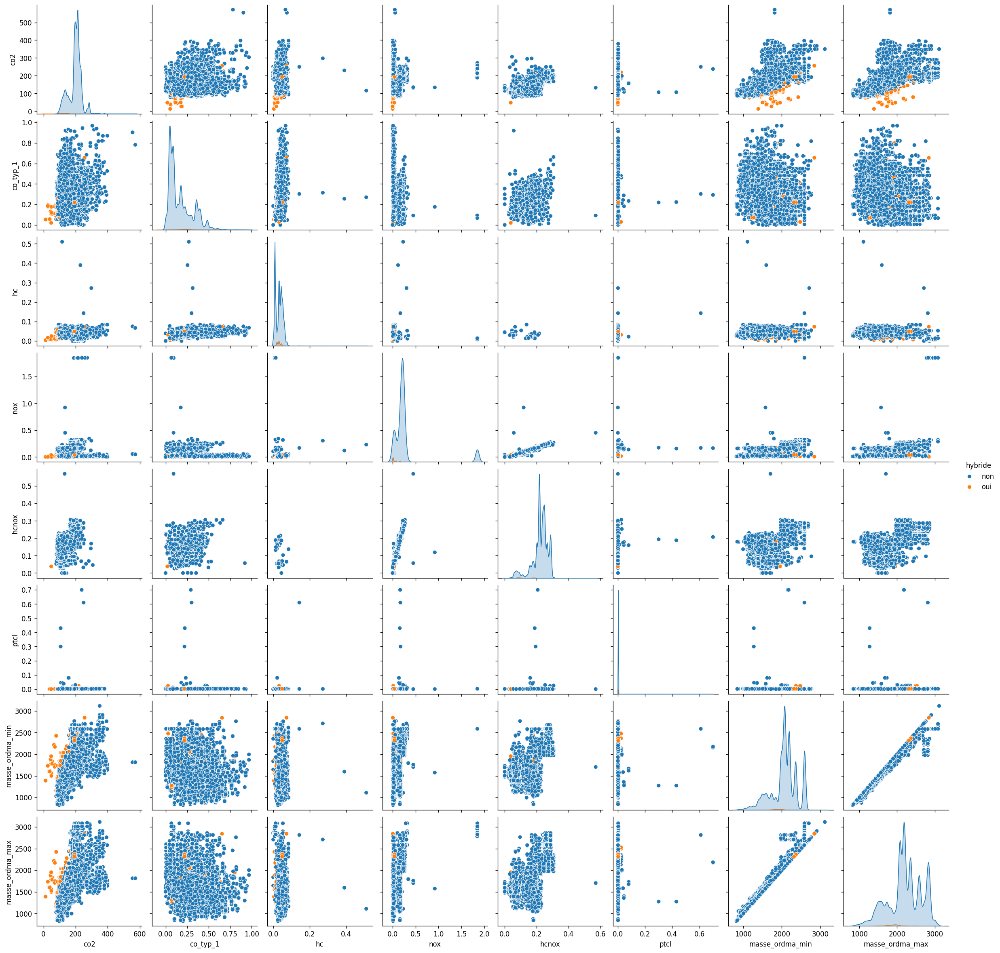

In [124]:
sns.pairplot(
    data=df[['co2'] + num_vars_list[6:]+['hybride']],
    dropna=True,
    hue='hybride',
    diag_kind='kde'
)

plt.show()

# 7. Final consideration on duplicates

In [130]:
df.to_csv(os.path.join(data_dir, "1-processed", "data_2012_1015.csv"), index=False)

In [125]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 159780 entries, 0 to 40051
Data columns (total 26 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   lib_mrq_utac       159780 non-null  object 
 1   lib_mod_doss       159780 non-null  object 
 2   lib_mod            159780 non-null  object 
 3   dscom              159780 non-null  object 
 4   tvv                159780 non-null  object 
 5   cod_cbr            159780 non-null  object 
 6   hybride            159780 non-null  object 
 7   puiss_admin_98     159780 non-null  float64
 8   puiss_max          159724 non-null  float64
 9   typ_boite_nb_rapp  159780 non-null  object 
 10  conso_urb          159543 non-null  float64
 11  conso_exurb        159543 non-null  float64
 12  conso_mixte        159622 non-null  float64
 13  co2                159622 non-null  float64
 14  co_typ_1           159090 non-null  float64
 15  hc                 36813 non-null   float64
 16  nox     

In [126]:
df.columns

Index(['lib_mrq_utac', 'lib_mod_doss', 'lib_mod', 'dscom', 'tvv', 'cod_cbr',
       'hybride', 'puiss_admin_98', 'puiss_max', 'typ_boite_nb_rapp',
       'conso_urb', 'conso_exurb', 'conso_mixte', 'co2', 'co_typ_1', 'hc',
       'nox', 'hcnox', 'ptcl', 'masse_ordma_min', 'masse_ordma_max',
       'champ_v9', 'date_maj', 'year', 'Carrosserie', 'gamme'],
      dtype='object')

<div class="alert alert-block alert-danger">
<b>Important:</b> 
    <p>Cars can have same caracteristics with different years and registration number.
    <br>To identify duplicated values we have to remove variables like cnit, date_maj etc from the dataset.</p>
    After corrections, check for duplicated values without considering columns like: `date_maj`, `champ_v9`, etc. That can be different for the same car with same characteristics.
Also, variables that has a lot of missing values like: `hcnox`, `ptcl`, `hc`, etc. must be removed from the comparison list. 

</div>

In [127]:
columns = ['tvv', 'cod_cbr', 'hybride', 'puiss_admin_98', 'puiss_max', 'typ_boite_nb_rapp',
           'conso_urb', 'conso_exurb', 'conso_mixte', 'co2', 'co_typ_1',
           'nox', 'masse_ordma_min', 'masse_ordma_max',
           'Carrosserie', 'gamme']
df[columns].duplicated().sum()

56290

In [128]:
df.drop_duplicates(subset=columns).info()

<class 'pandas.core.frame.DataFrame'>
Index: 103490 entries, 0 to 40051
Data columns (total 26 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   lib_mrq_utac       103490 non-null  object 
 1   lib_mod_doss       103490 non-null  object 
 2   lib_mod            103490 non-null  object 
 3   dscom              103490 non-null  object 
 4   tvv                103490 non-null  object 
 5   cod_cbr            103490 non-null  object 
 6   hybride            103490 non-null  object 
 7   puiss_admin_98     103490 non-null  float64
 8   puiss_max          103435 non-null  float64
 9   typ_boite_nb_rapp  103490 non-null  object 
 10  conso_urb          103312 non-null  float64
 11  conso_exurb        103312 non-null  float64
 12  conso_mixte        103390 non-null  float64
 13  co2                103390 non-null  float64
 14  co_typ_1           102935 non-null  float64
 15  hc                 27526 non-null   float64
 16  nox     